Connected to shocks (Python 3.10.18)

Adjusting observers number


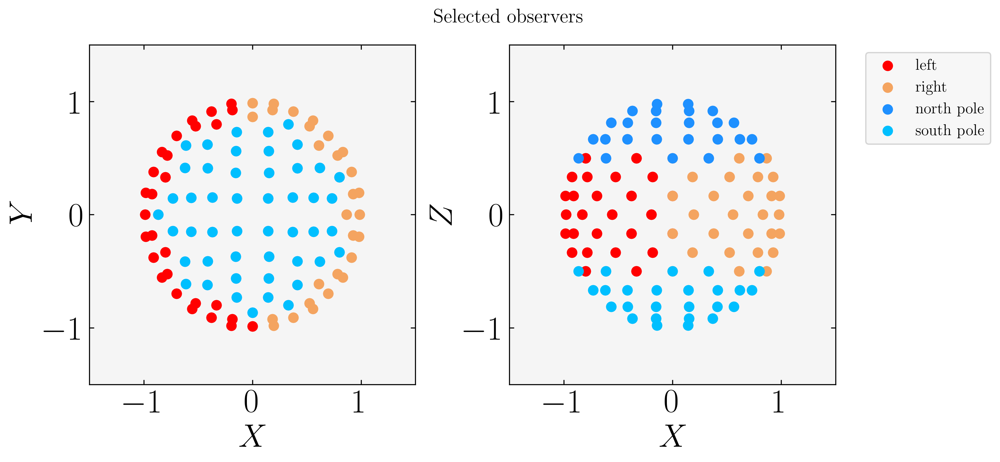

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs= split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    for j, indices in enumerate(indices_sec):
        print(j)
        cond_sec_r = np.intersect1d(cond_r, indices)
        Ekin[j] = r**2/np.sum(dim_cell_wind[indices]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
        print(Ekin[j]/Ledd_sol)
    # Save data
    data_tosave = np.concatenate(([snap], [tfb], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

0
5.019288577477742e-13
1
0.0
2
0.0
3
0.0
0
5.899037316024945e-13
1
0.0
2
0.0
3
0.0
0
6.932982776085275e-13
1
0.0
2
0.0
3
0.0
0
8.148151570921828e-13
1
0.0
2
0.0
3
0.0
0
9.576307365385435e-13
1
0.0
2
0.0
3
0.0
0
1.125478115596228e-12
1
0.0
2
0.0
3
0.0
0
1.3227447076987715e-12
1
0.0
2
0.0
3
0.0
0
1.5545869239920513e-12
1
0.0
2
0.0
3
0.0
0
1.827064958325603e-12
1
0.0
2
0.0
3
0.0
0
2.1473011964935336e-12
1
0.0
2
0.0
3
0.0
0
2.523666390432105e-12
1
0.0
2
0.0
3
0.0
0
2.965998463837674e-12
1
0.0
2
0.0
3
0.0
0
3.4858596686312356e-12
1
0.0
2
0.0
3
0.0
0
4.096838814160246e-12
1
0.0
2
0.0
3
0.0
0
4.814906469198292e-12
1
0.0
2
0.0
3
0.0
0
5.6588324214750896e-12
1
0.0
2
0.0
3
0.0
0
6.6506763068378994e-12
1
0.0
2
0.0
3
0.0
0
7.816364232748413e-12
1
0.0
2
0.0
3
0.0
0
9.186366468651214e-12
1
0.0
2
0.0
3
0.0
0
1.0796493917567369e-11
1
0.0
2
0.0
3
0.0
0
1.2688834188125261e-11
1
0.0
2
0.0
3
0.0
0
1.4912851735298723e-11
1
0.0
2
0.0
3
0.0
0
1.7526680826763968e-11
1
0.0
2
0.0
3
0.0
0
2.059864513211443e-11


Adjusting observers number


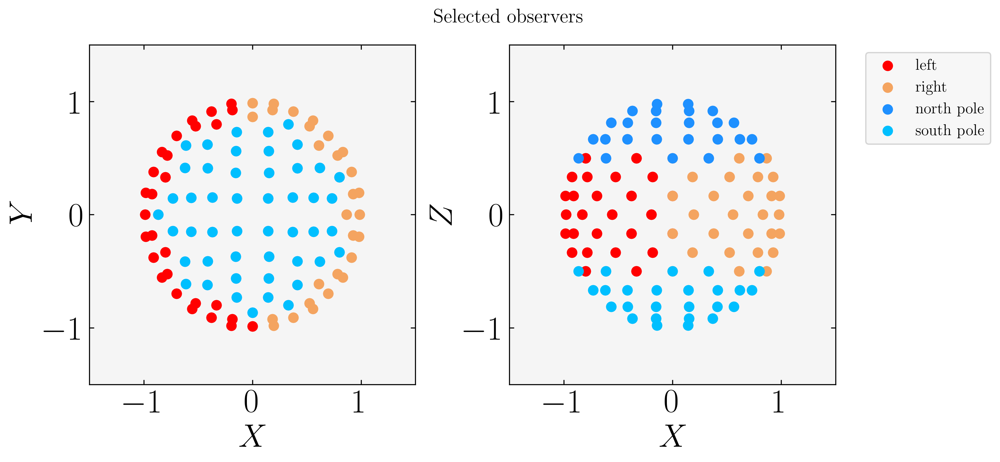

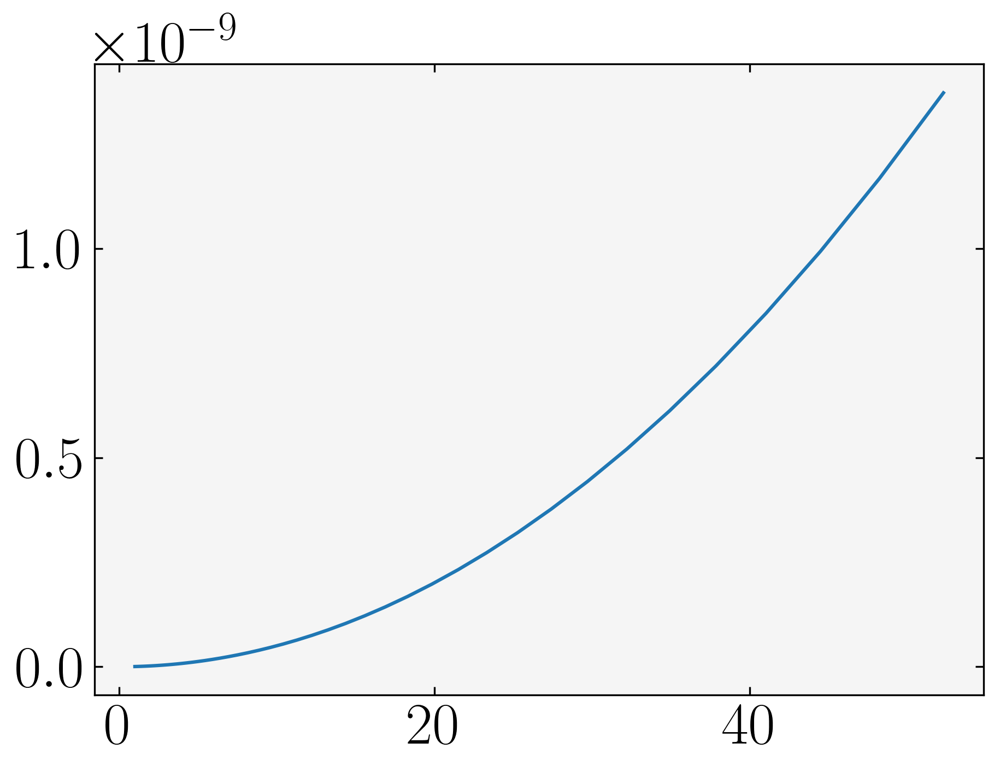

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs= split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    for j, indices in enumerate(indices_sec):
        print(j)
        cond_sec_r = np.intersect1d(cond_r, indices) 
        Ekin[i] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([snap], [tfb], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

0
1
2
3


<ipython-input-5-a8e7bb9f8a65>:28: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[i] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-5-a8e7bb9f8a65>:28: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[i] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


0
1
2
3
0
1
2
3
0
1
2
3
0


IndexError: index 4 is out of bounds for axis 0 with size 4

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

: 

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs= split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    print(cond_r)
    for j, indices in enumerate(indices_sec):
        print(indices)
        cond_sec_r = np.intersect1d(cond_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([snap], [tfb], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

[False False False ... False False False]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]


<ipython-input-7-622a8d6890f7>:29: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-7-622a8d6890f7>:29: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


[False False False ... False False False]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[False False False ... False False False]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[False False False ... False False False]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[False False False ... False False False]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      

KeyboardInterrupt: 

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

: 

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs= split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))
print(len(indices_sec))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    print(indices_r)

    for j, indices in enumerate(indices_sec):
        print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([snap], [tfb], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

4
[4398345 4398346 4398349 ... 6700082 6710380 6710491]
[      0       1       2 ... 9898902 9898903 9898906]


<ipython-input-9-e1b79ed7eafa>:33: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-9-e1b79ed7eafa>:33: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[4397721 4397723 4397733 ... 6710632 6710673 6710676]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[4397711 4397712 4397713 ... 6710636 6710660 6710679]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[4397790 4397800 4397801 ... 6710697 6716098 6830566]
[      0       1       2 ... 9898902 9898903 9898906]
[2241427 2241428 2241429 ... 9898905 9898908 9898912]
[    166     167     168 ... 9898901 9898904 9898910]
[     40      42      43 ... 9898907 9898909 9898911]
[4397922 4397976 4397978 ...

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

Adjusting observers number


python(59510) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


KeyboardInterrupt: 

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-12-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-12-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


python(59674) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


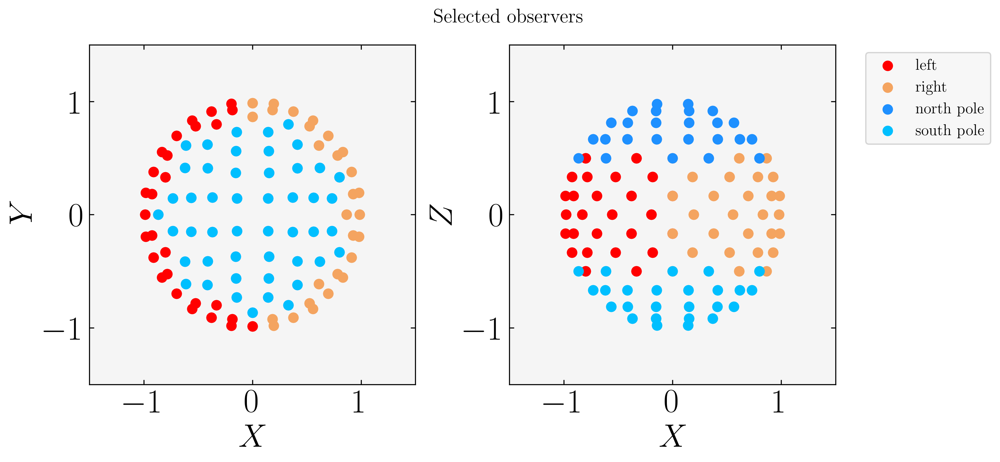

IndexError: index 5 is out of bounds for axis 0 with size 5

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

Adjusting observers number


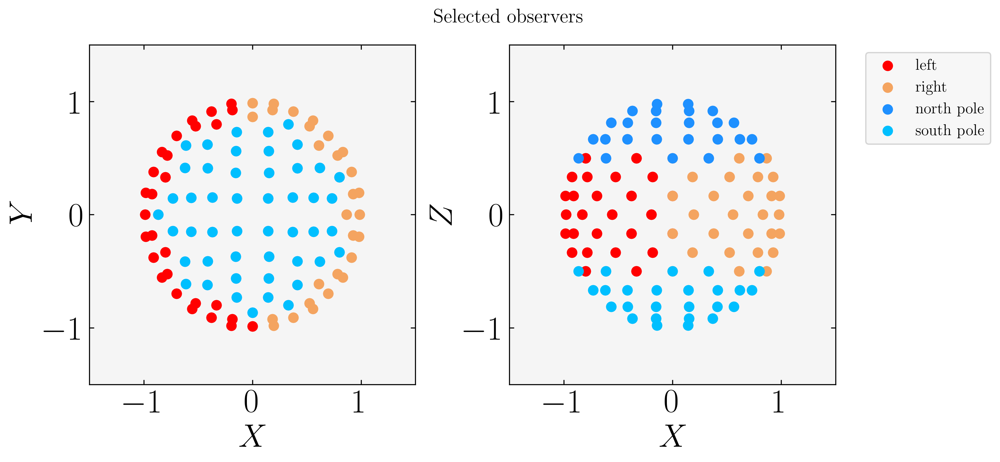

IndexError: index 5 is out of bounds for axis 0 with size 5

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    tfbH, LkL, LkR, LkN, LkS = Lkin[1], Lkin[2], Lkin[3], Lkin[4], Lkin[5]
    plt.figure(figsize=(7,5))
    plt.plot(r_array/Rt, LkL/Ledd_sol)

Adjusting observers number


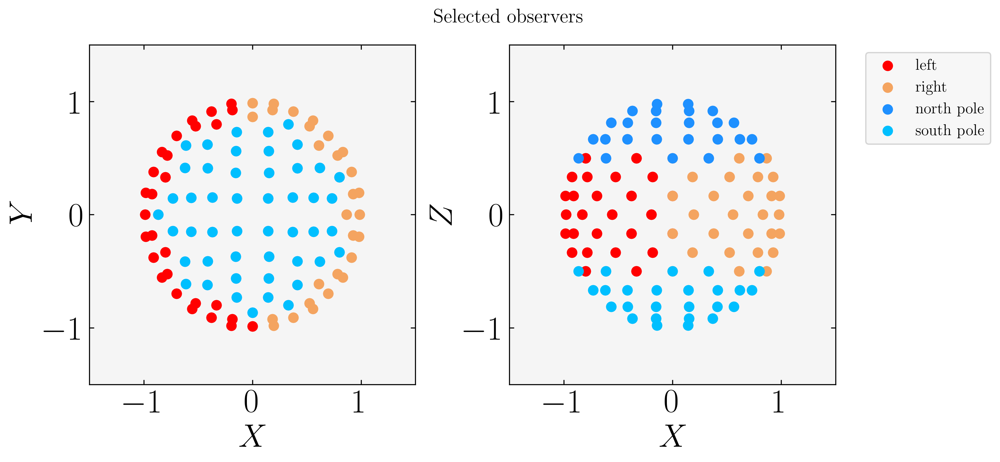

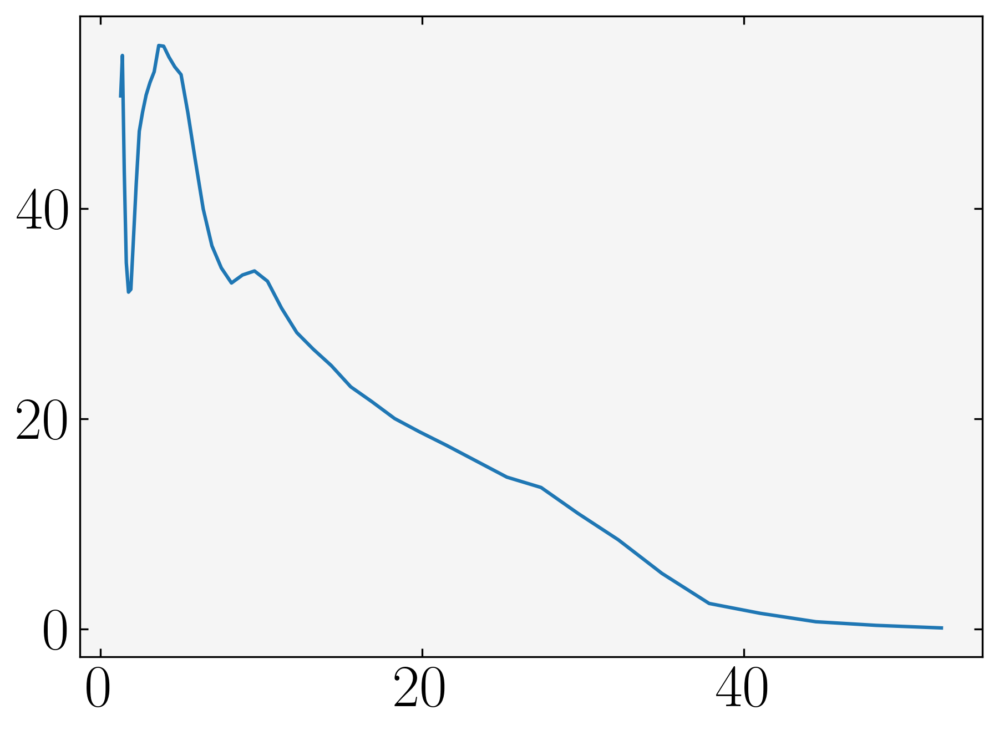

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    plt.figure(figsize=(7,5))
    plt.plot(r_toplot/Rt, LkL/Ledd_sol)

Adjusting observers number


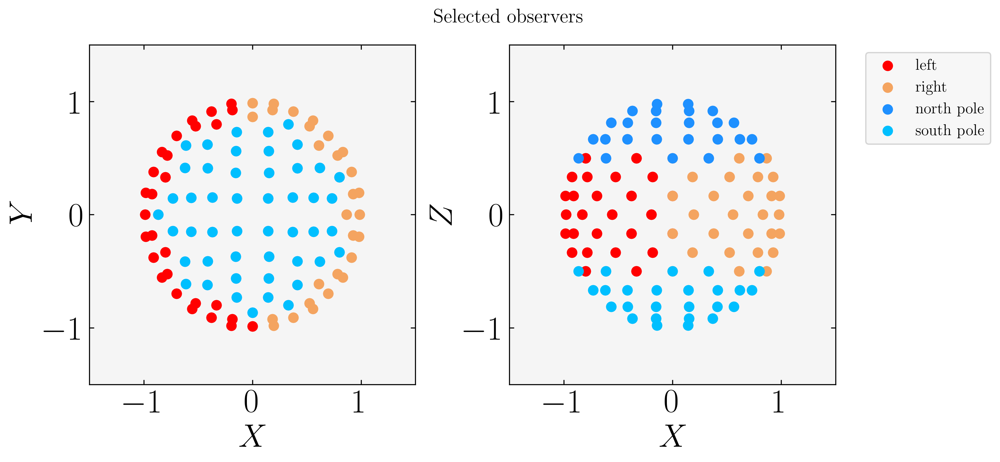

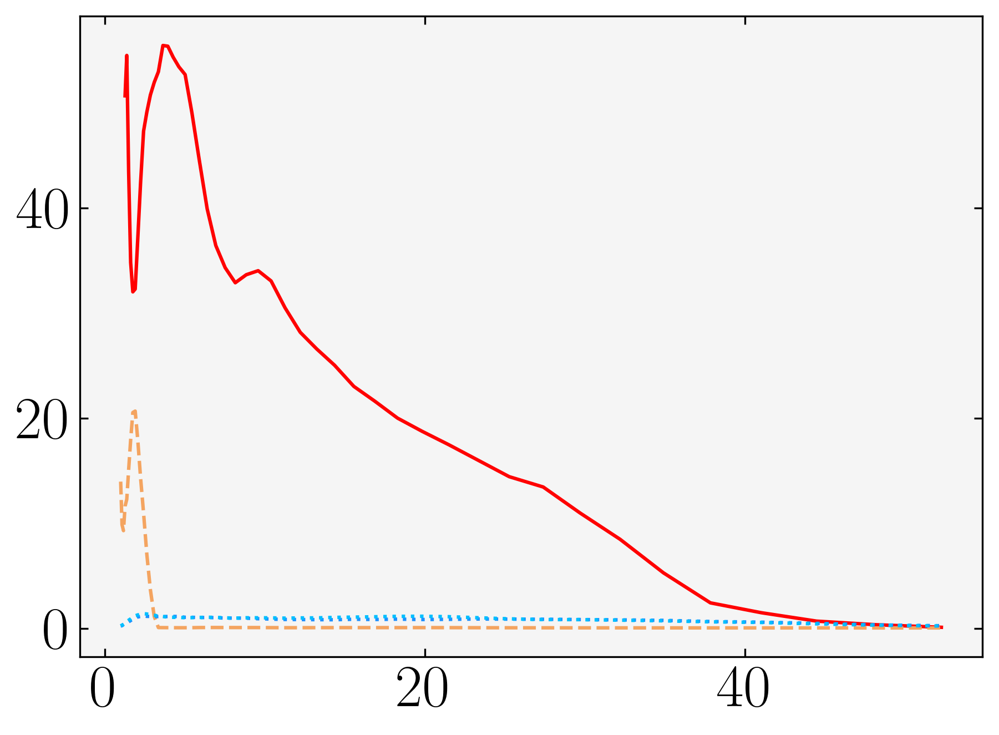

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    plt.figure(figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN, LkS]):
        plt.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

Adjusting observers number


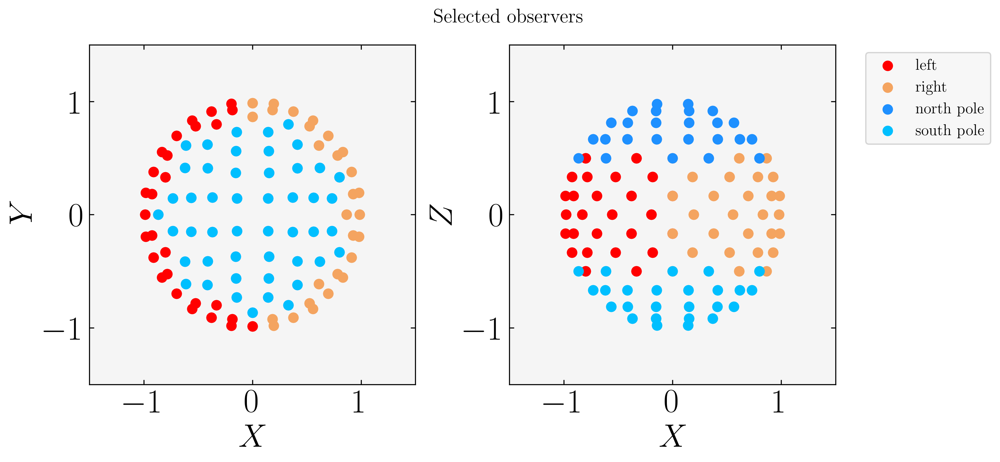

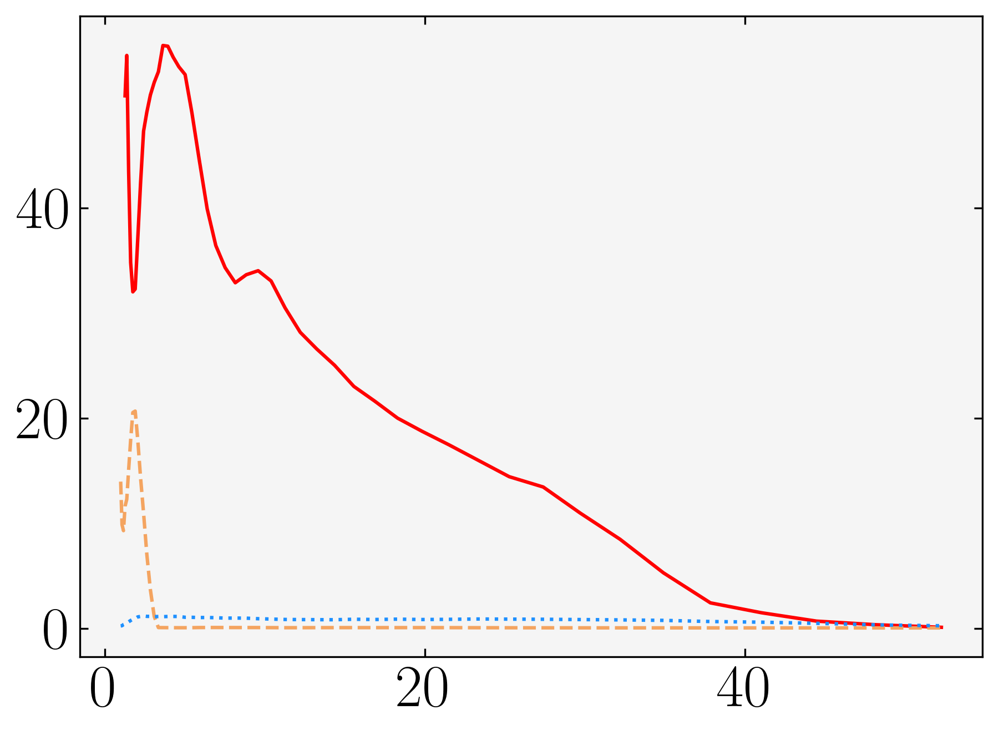

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    plt.figure(figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        plt.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

Adjusting observers number


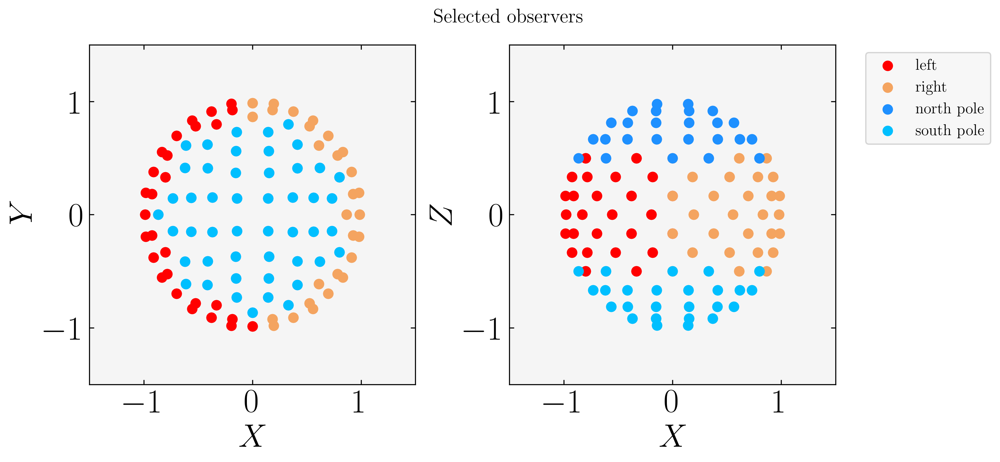

python(59782) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59783) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59784) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59785) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


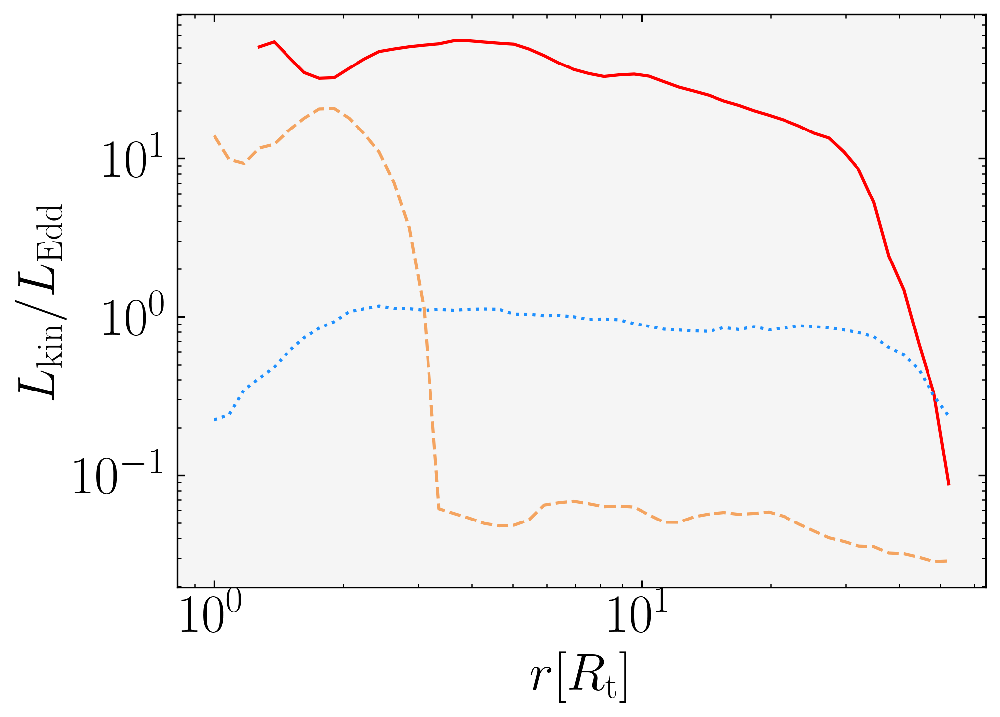

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    plt.figure(figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        plt.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    plt.loglog()
    plt.xlabel(r'$r [R_{\rm t}]$')
    plt.ylabel(r'$L_{\rm kin}/L_{\rm Edd}$')

Adjusting observers number


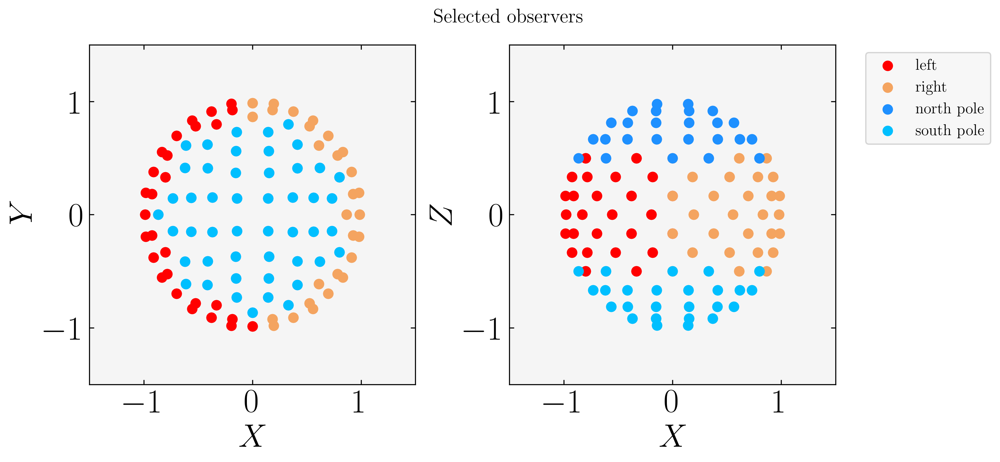

python(59797) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59798) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


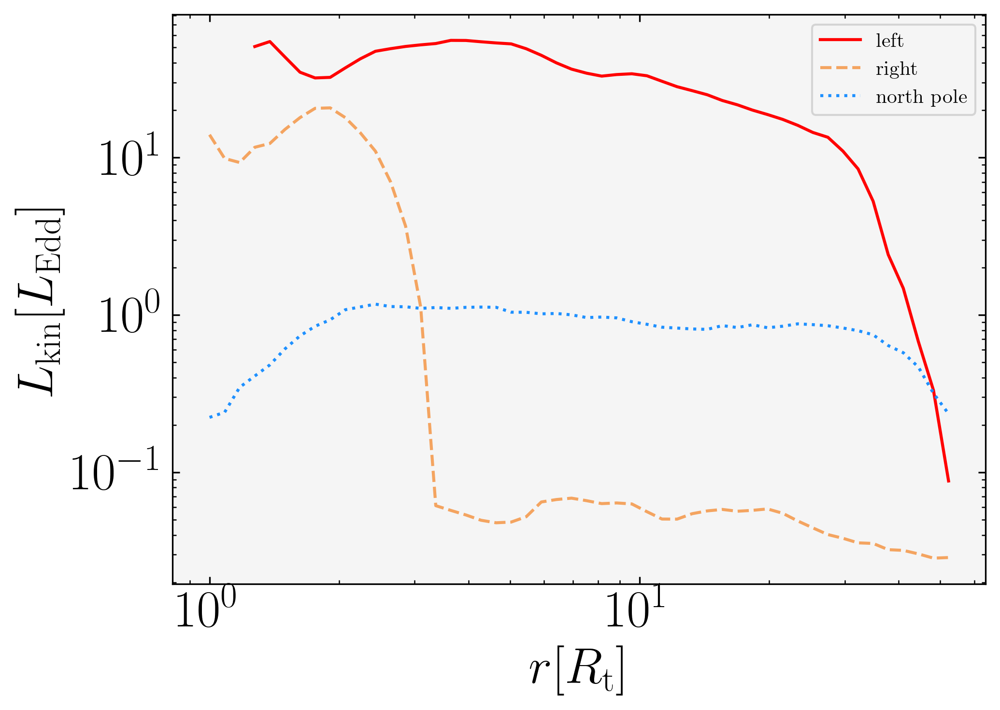

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='both', direction='in', right=True, top=True)
    ax.legend()
    plt.tight_layout()

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='both', direction='in', length=9
    ax.legend()
    plt.tight_layout()

SyntaxError: '(' was never closed (<ipython-input-20-19ef94b9795c>, line 19)

Adjusting observers number


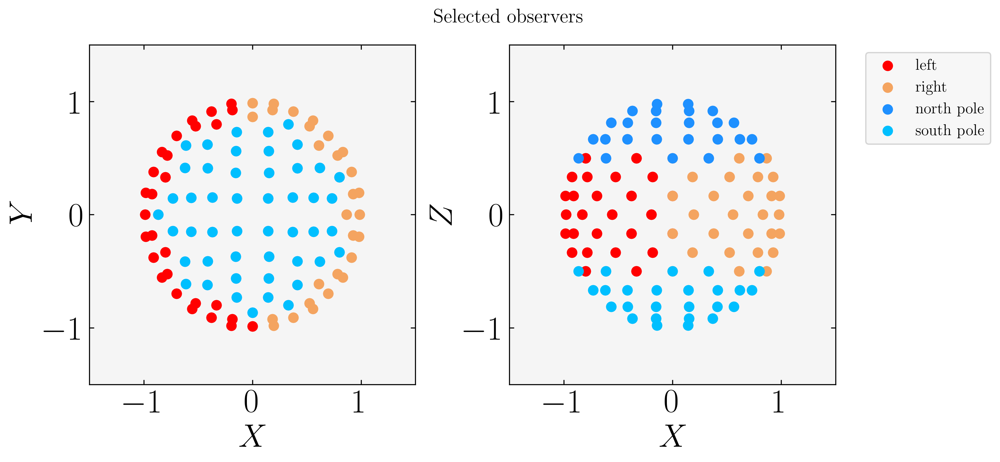

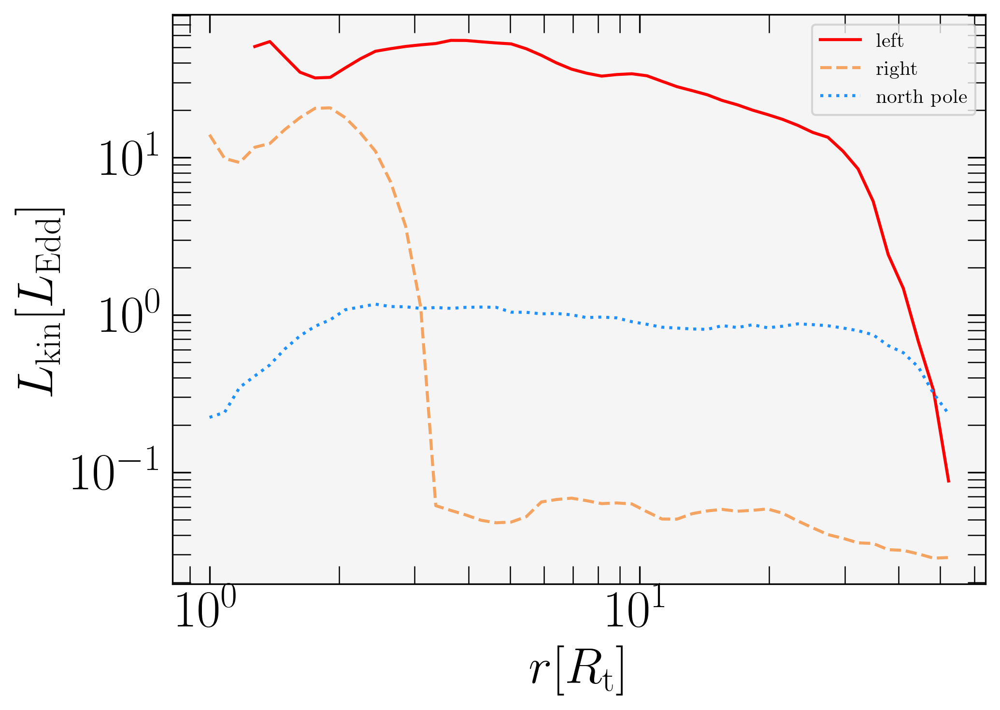

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='both', direction='in', length=9)
    ax.legend()
    plt.tight_layout()

Adjusting observers number


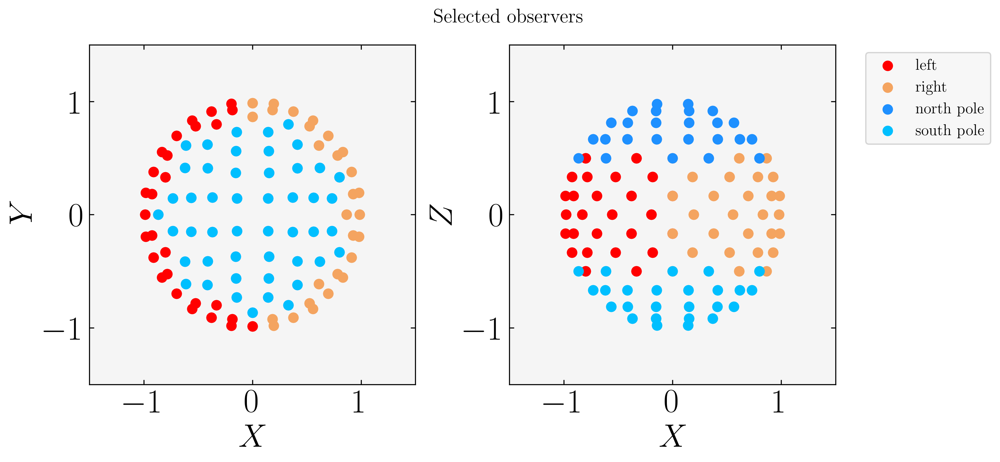

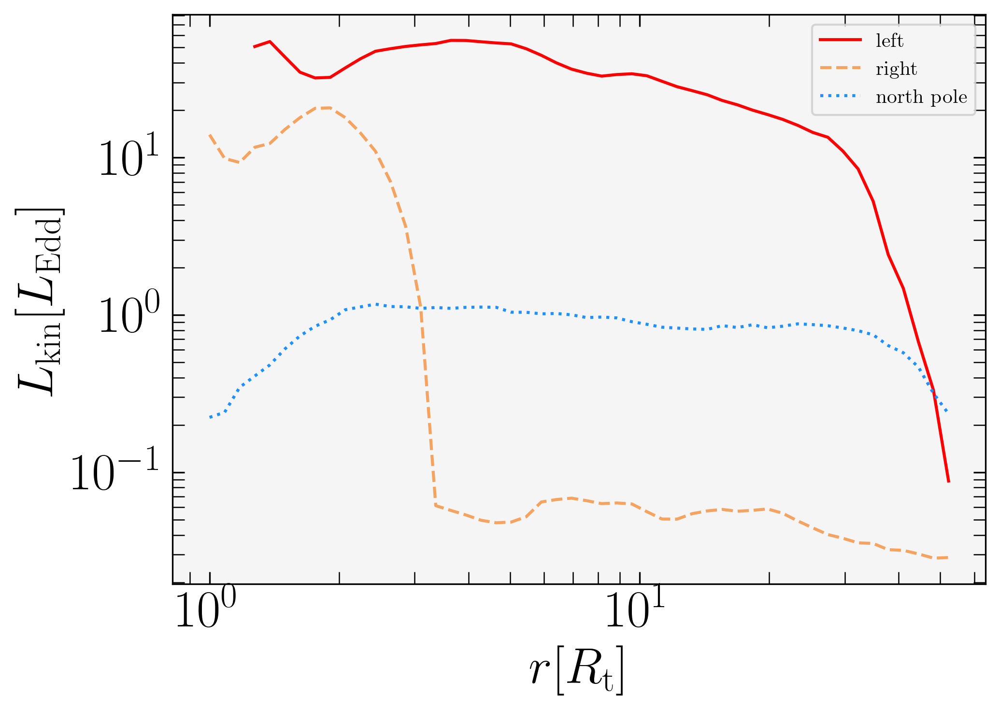

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='both', direction='in', length=6)
    ax.legend()
    plt.tight_layout()

Adjusting observers number


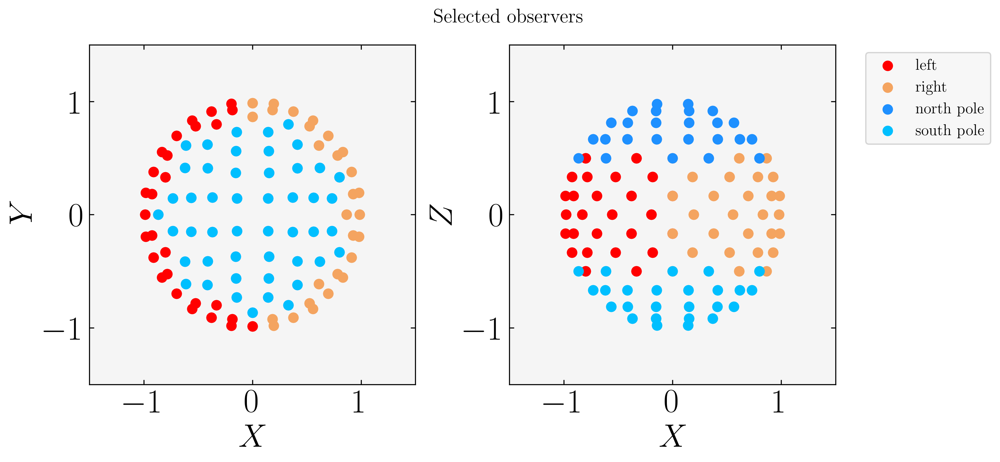

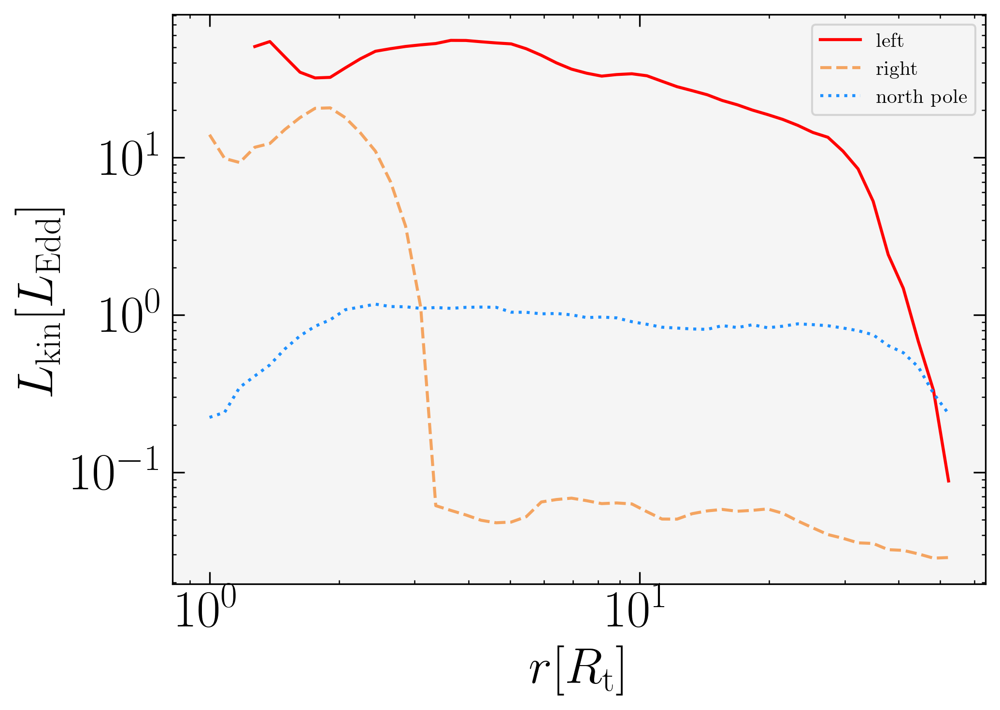

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.legend()
    plt.tight_layout()

Adjusting observers number


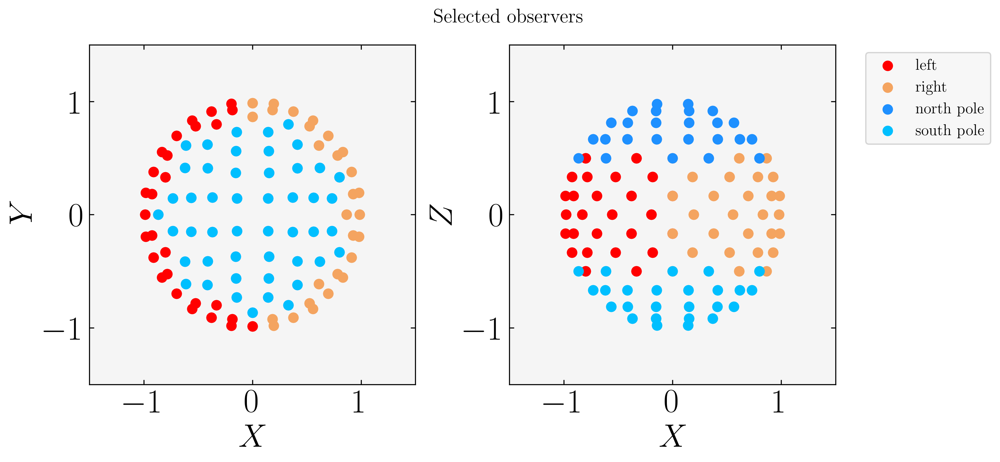

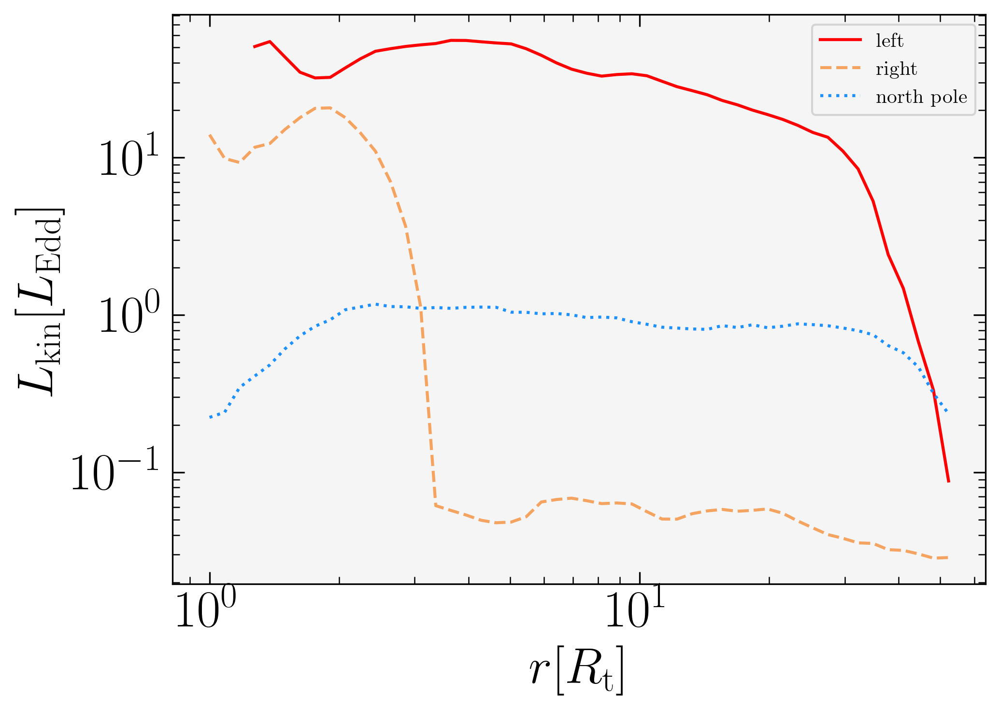

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    plt.tight_layout()

Adjusting observers number


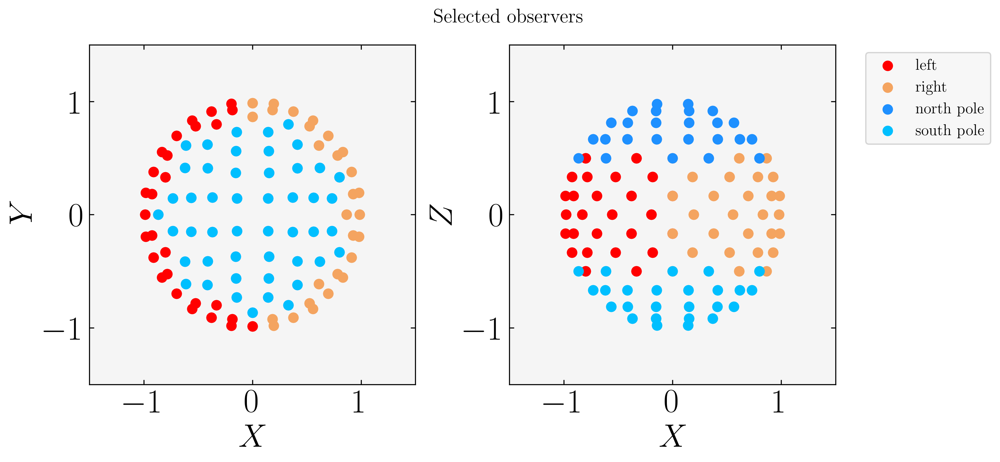

python(59815) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59816) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


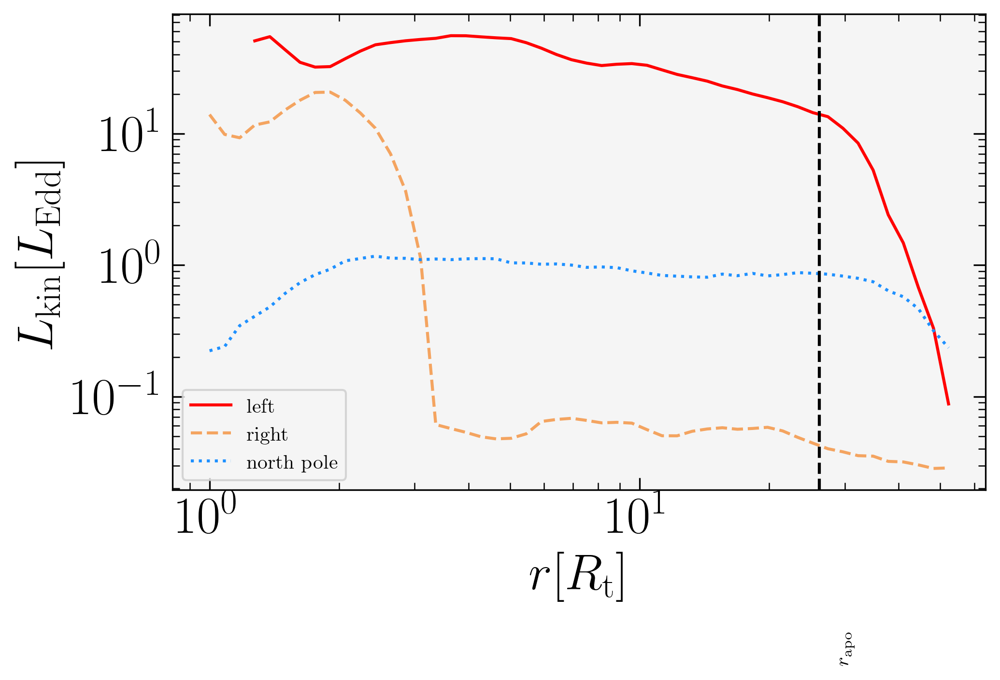

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.1, 1e-3, r'$r_{\rm apo}$', rotation=90)
    plt.tight_layout()

Adjusting observers number


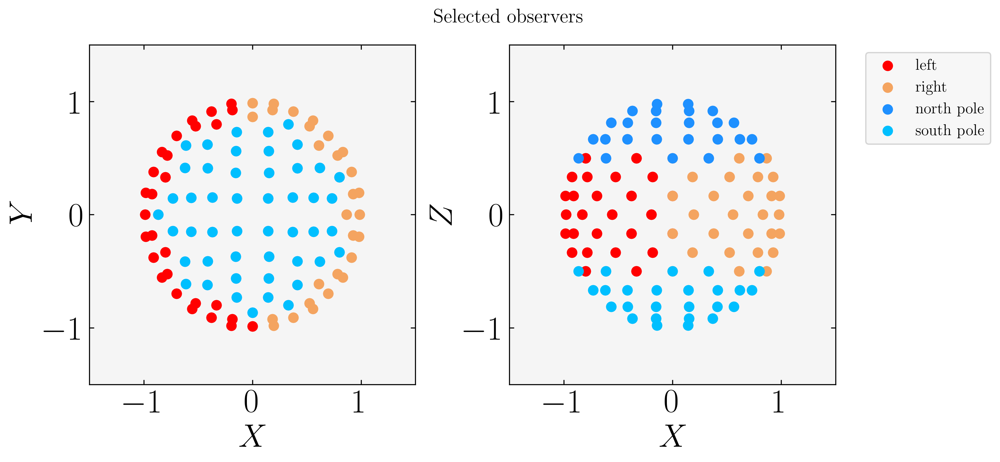

python(59819) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59820) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


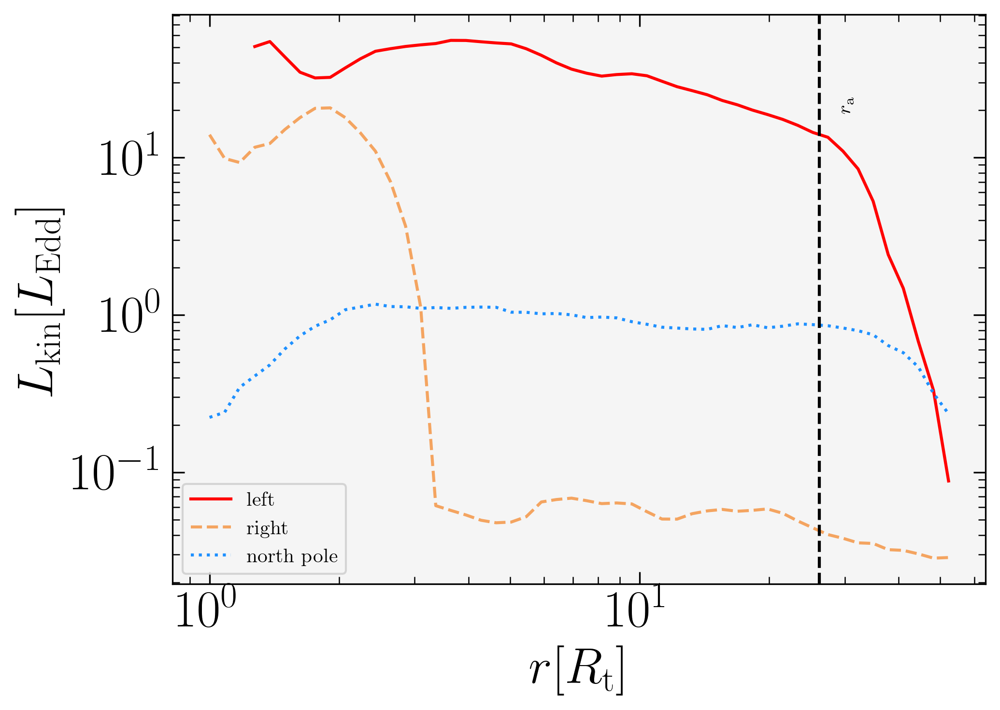

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.1, 2e1, r'$r_{\rm a}$', rotation=90)
    plt.tight_layout()

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.0.5, 2e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    plt.tight_layout()

SyntaxError: invalid syntax. Perhaps you forgot a comma? (<ipython-input-27-f8a100a39d58>, line 23)

Adjusting observers number


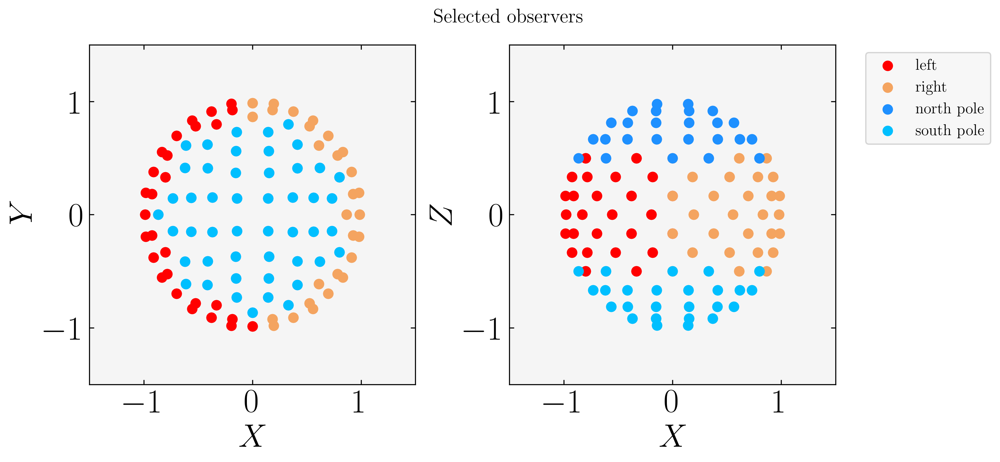

python(59822) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59823) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


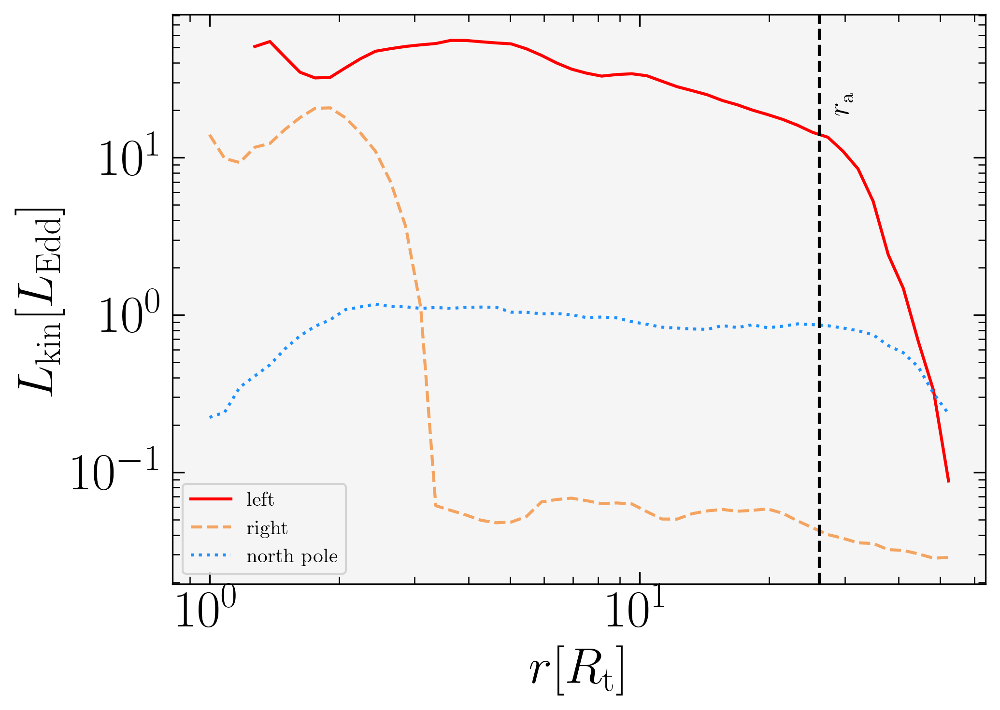

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.05, 2e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    plt.tight_layout()

Adjusting observers number


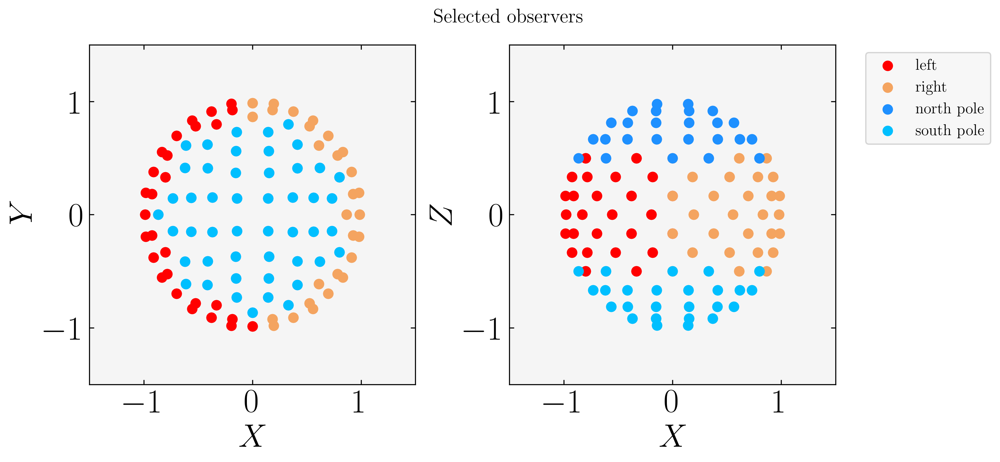

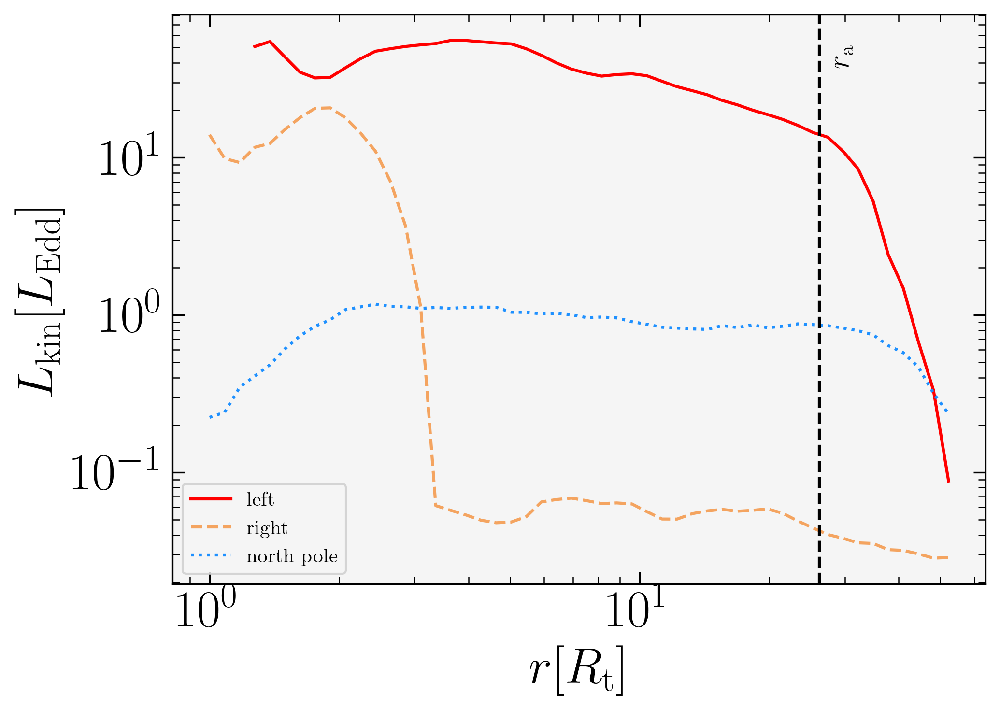

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)

    Lkin = np.loadtxt(csv_path, 
                            delimiter = ',', 
                            skiprows=1, 
                            unpack=True) 
    r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for i, Lum in enumerate([LkL, LkR, LkN]):
        ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle=lines_obs[i])

    ax.loglog()
    ax.set_xlabel(r'$r [R_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.05, 4e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 151
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-31-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-31-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 76
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

Adjusting observers number


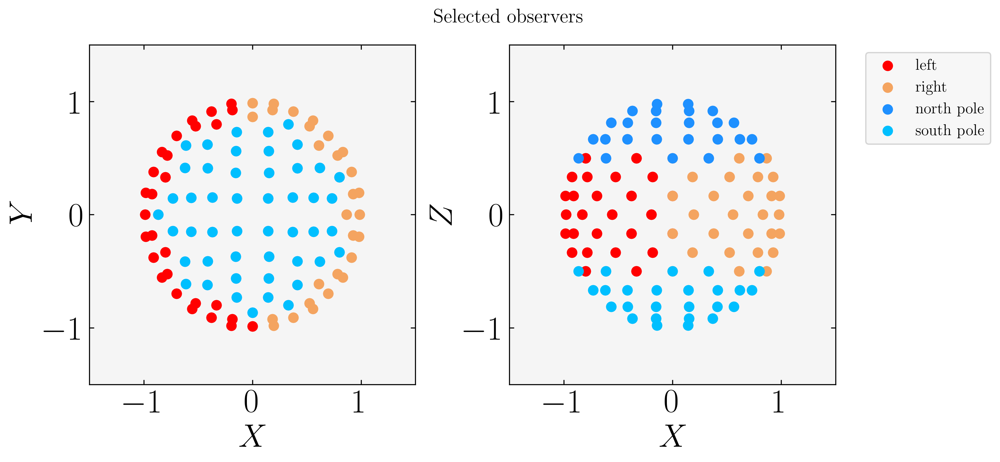

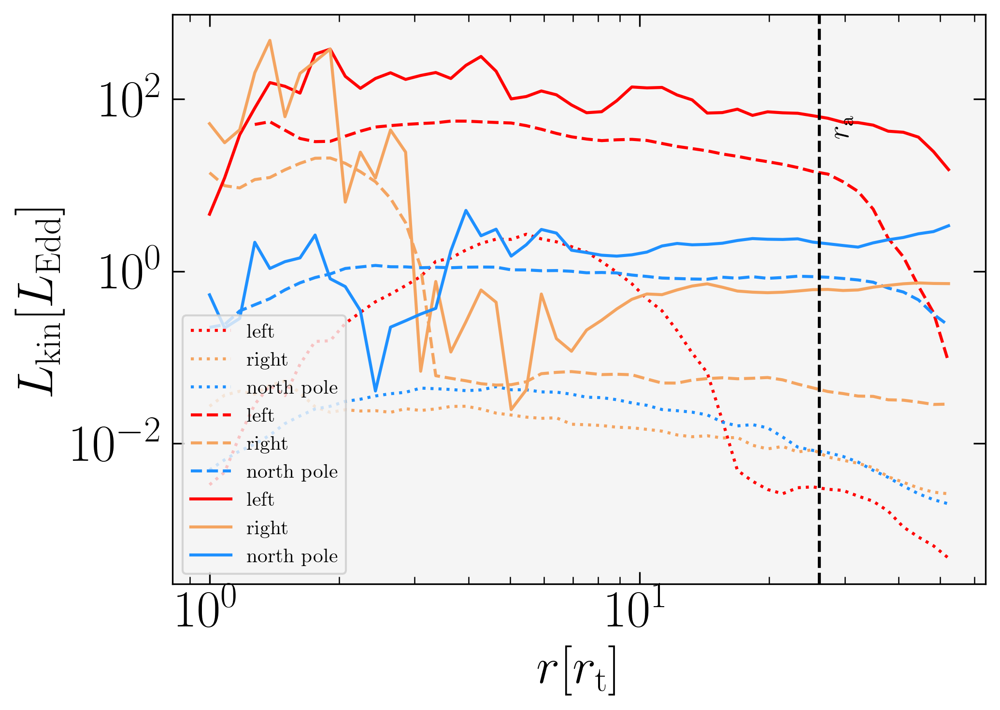

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, 1, figsize=(7,5))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax.plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_time[s])

    ax.loglog()
    ax.set_xlabel(r'$r [r_{\rm t}]$')
    ax.set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax.tick_params(which='major', direction='in', length=6)
    ax.tick_params(which='minor', direction='in', length=3.5)
    ax.legend()
    ax.axvline(apo/Rt, color='k', linestyle='--')
    ax.text(apo/Rt*1.05, 4e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    plt.tight_layout()

Adjusting observers number


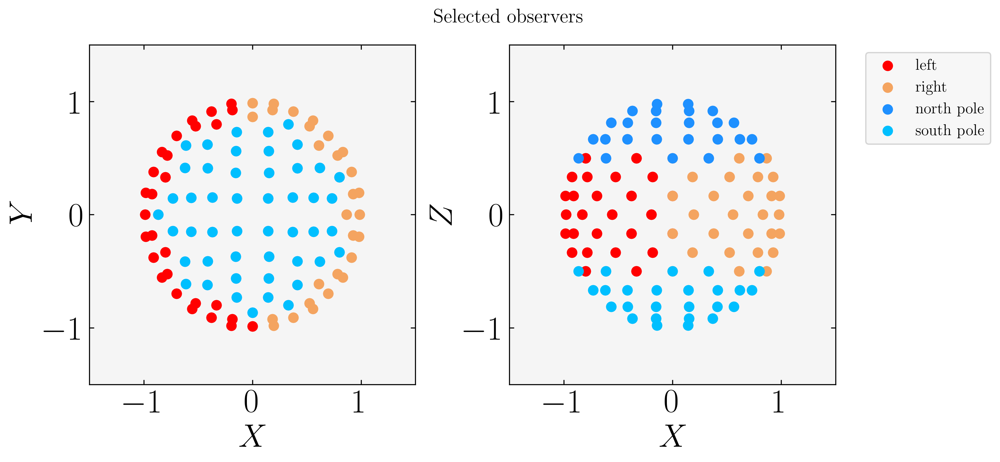

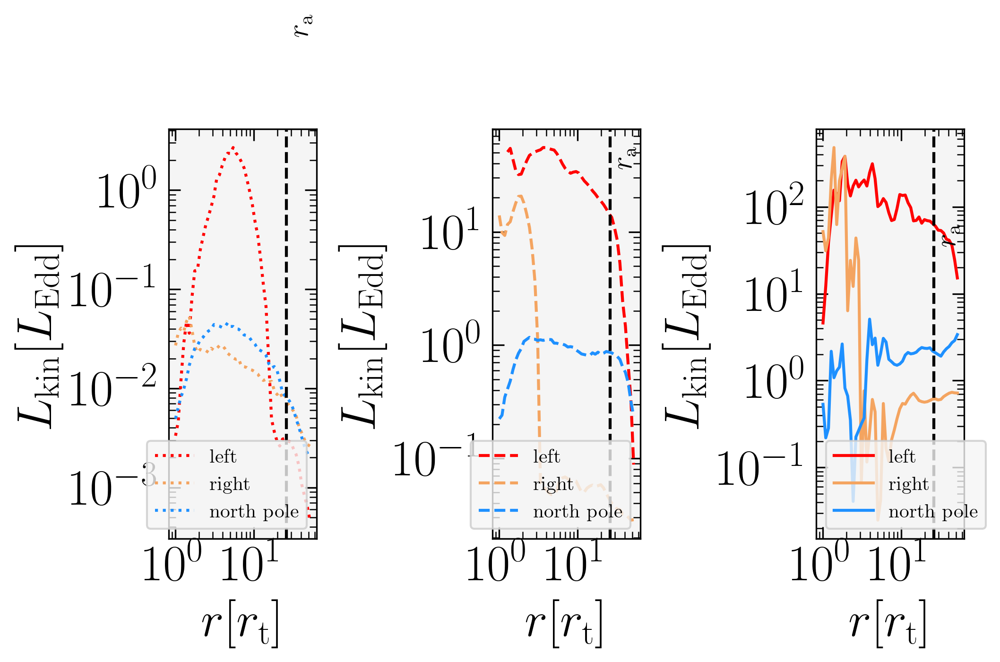

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(7,5))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_time[s])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, 4e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    plt.tight_layout()

Adjusting observers number


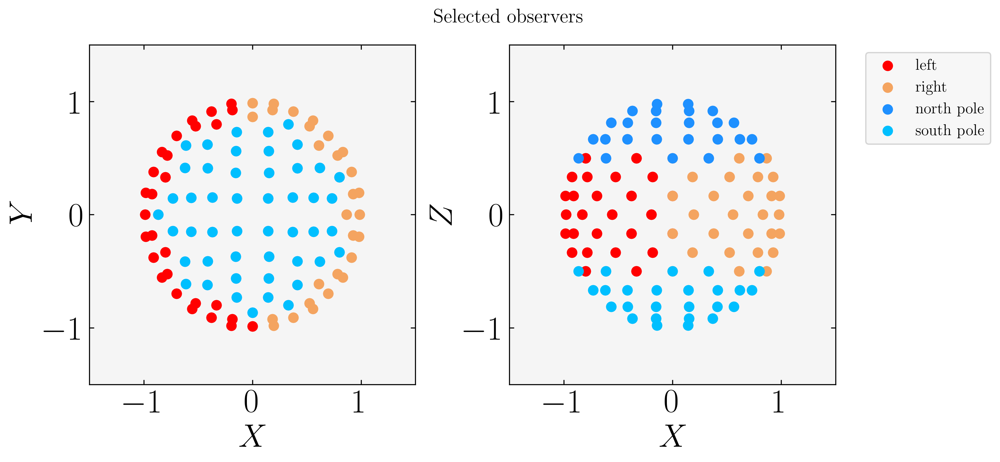

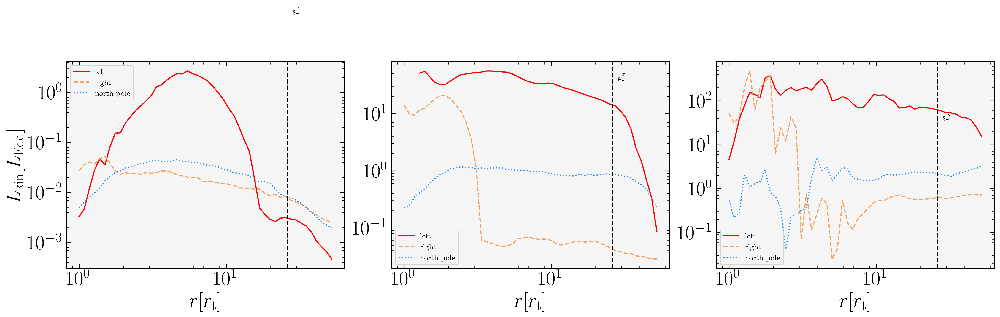

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(18,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, 4e1, r'$r_{\rm a}$', rotation=90, fontsize=15)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    plt.tight_layout()

Adjusting observers number


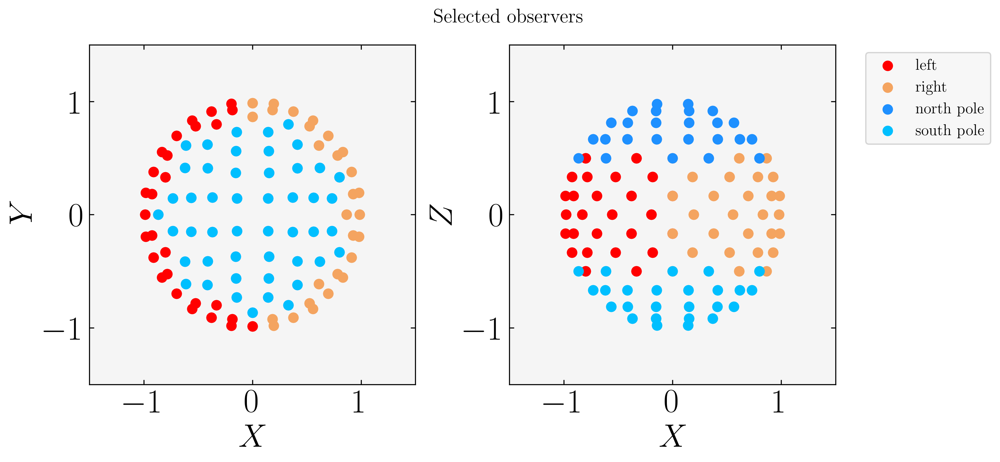

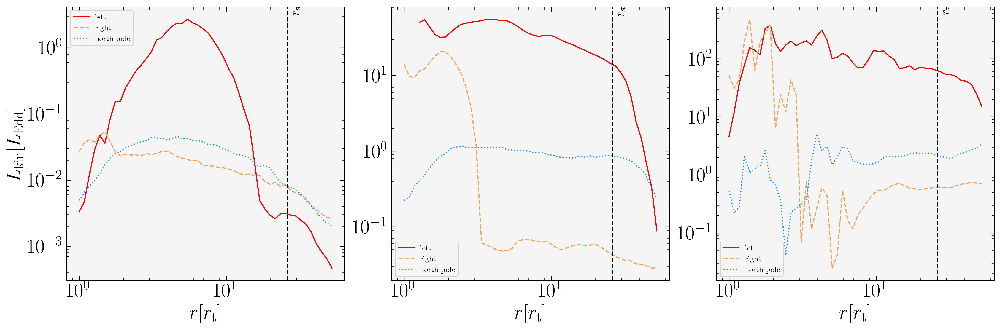

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(18,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.8, r'$r_{\rm a}$', rotation=90, fontsize=15)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    plt.tight_layout()

Adjusting observers number


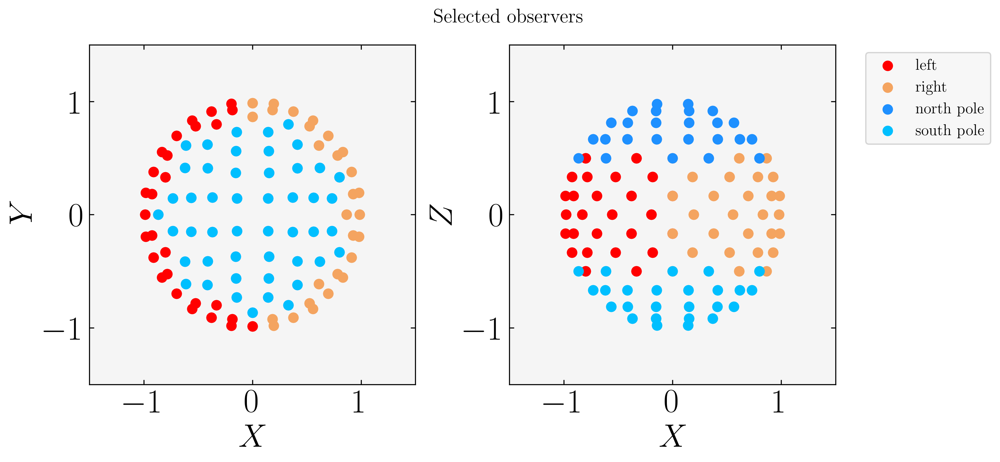

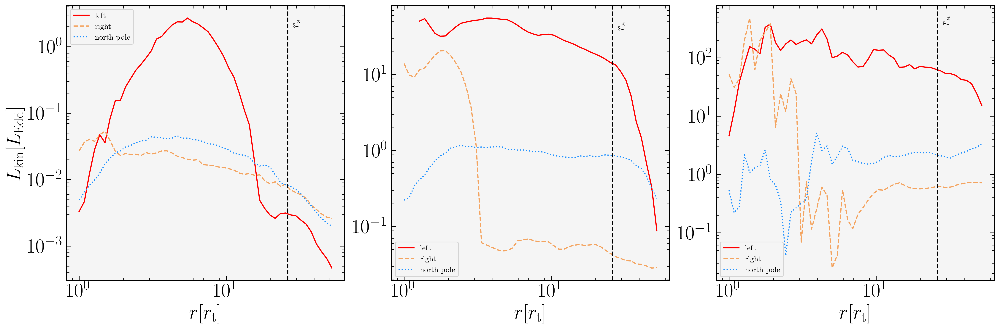

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(18,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=15)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    plt.tight_layout()

Adjusting observers number


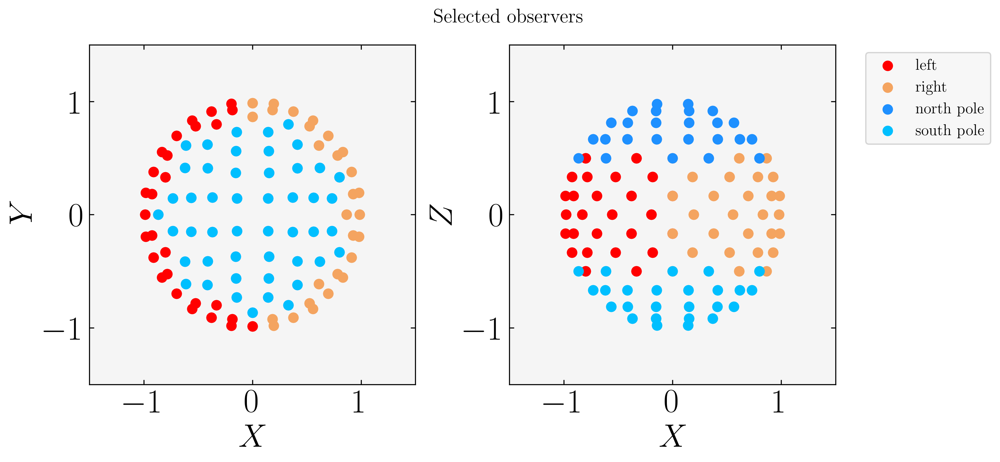

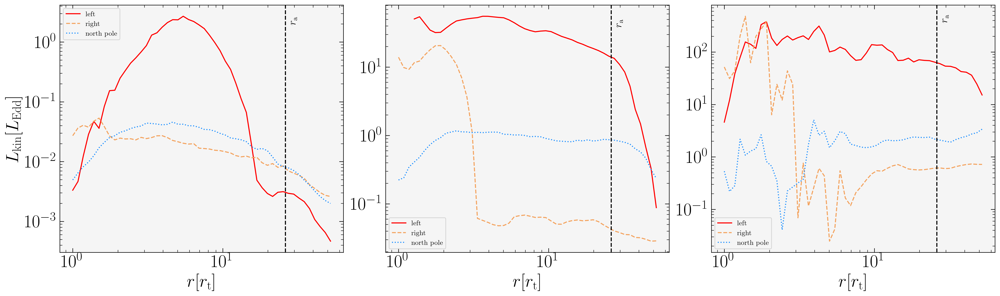

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=15)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    plt.tight_layout()

Adjusting observers number


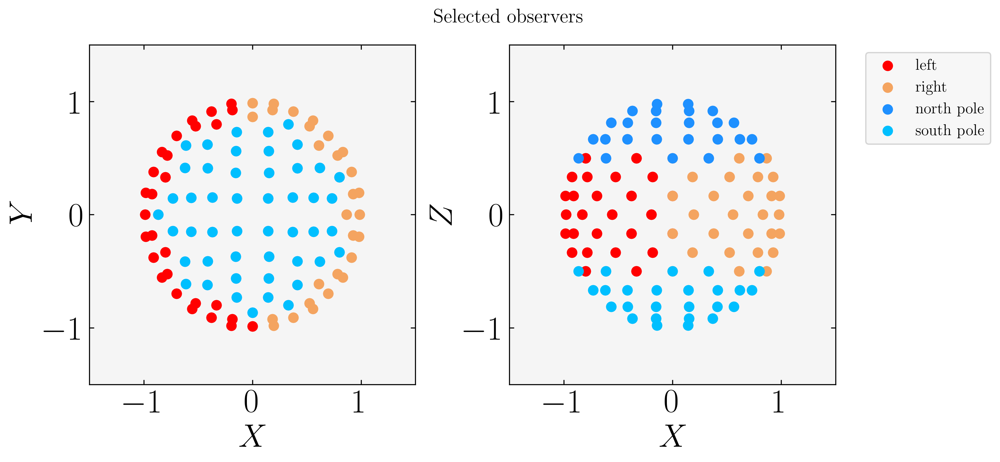

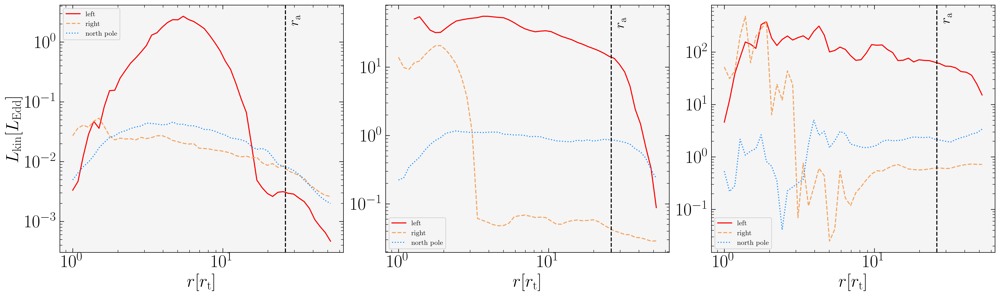

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].legend()
        ax[s].axvline(apo/Rt, color='k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    plt.tight_layout()

Adjusting observers number


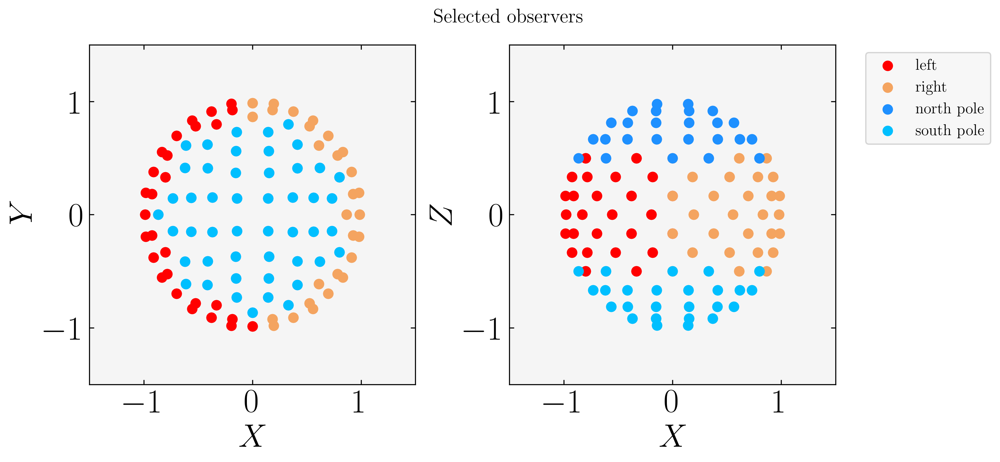

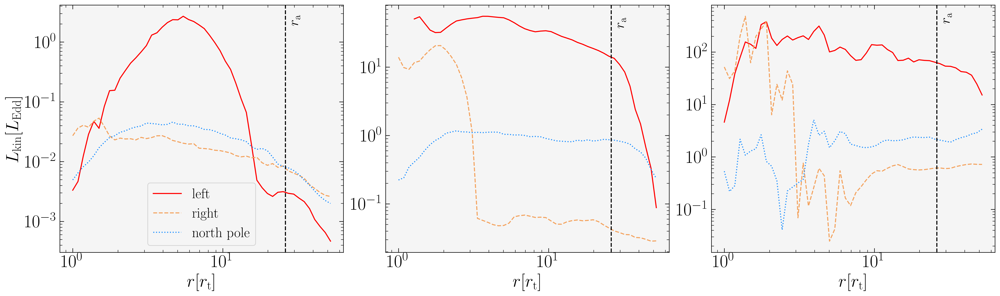

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


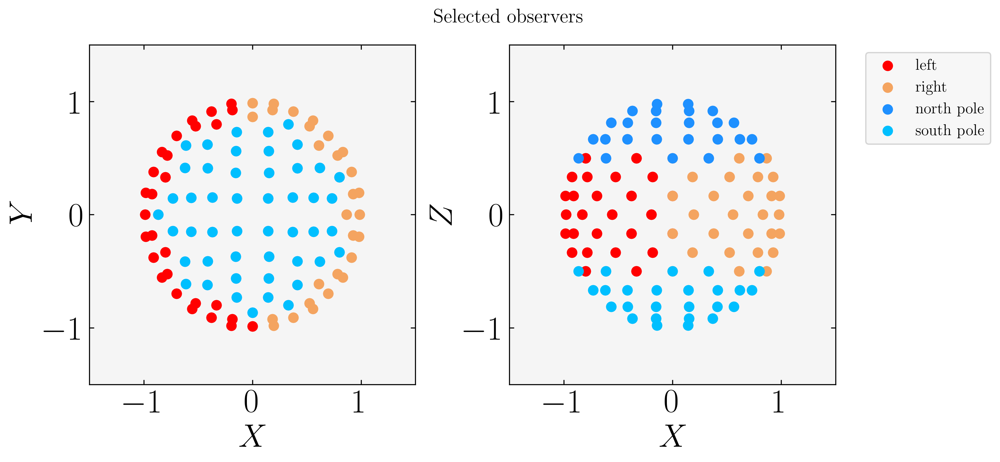

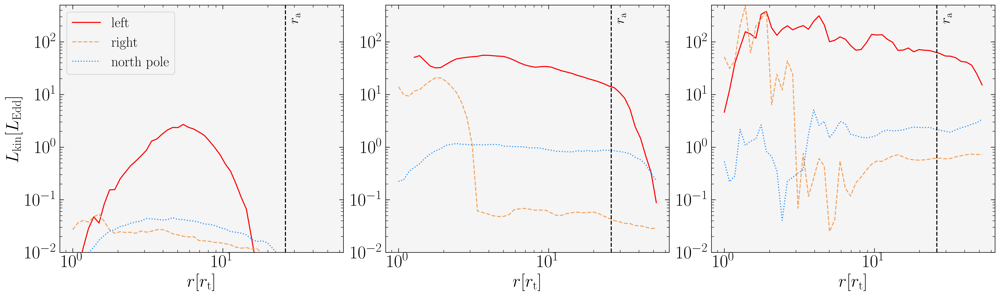

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


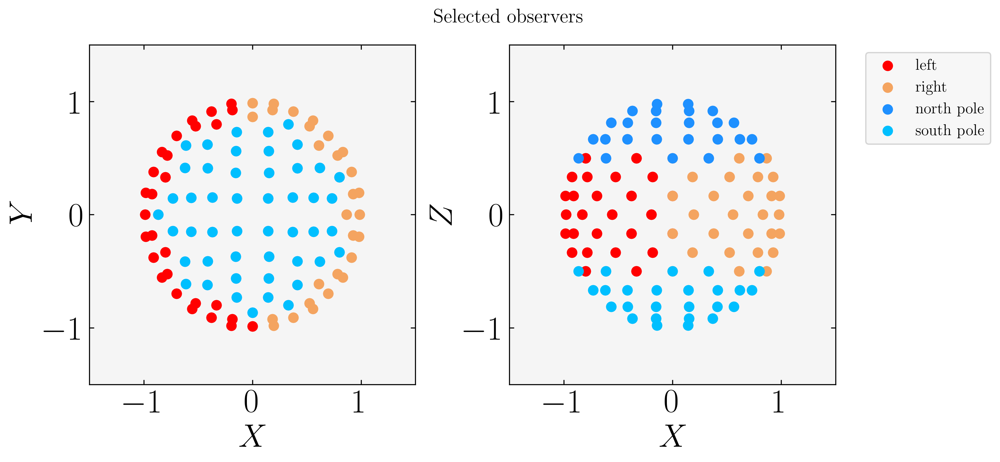

python(60240) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60241) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60242) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60243) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60244) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60245) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


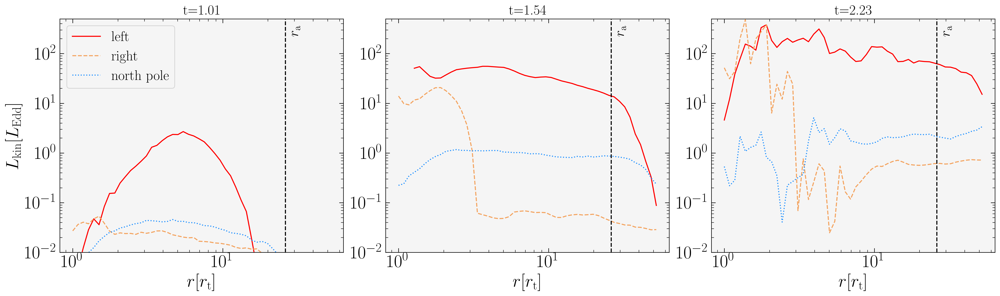

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(fr't={tfb:.2f}', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(fr't={tfb:.2f} $/t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

SyntaxError: f-string expression part cannot include a backslash (<ipython-input-44-9873de7518e3>, line 30)

Adjusting observers number


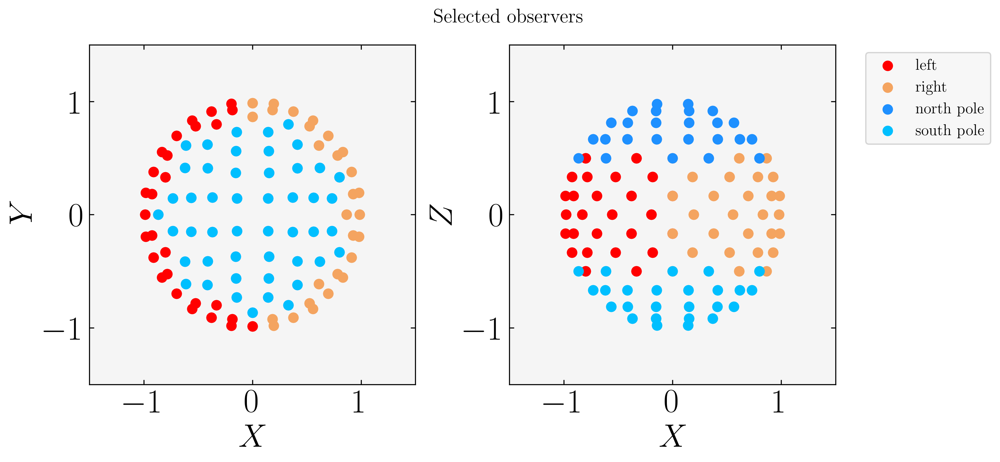

python(60249) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60250) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60251) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60252) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60253) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60254) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


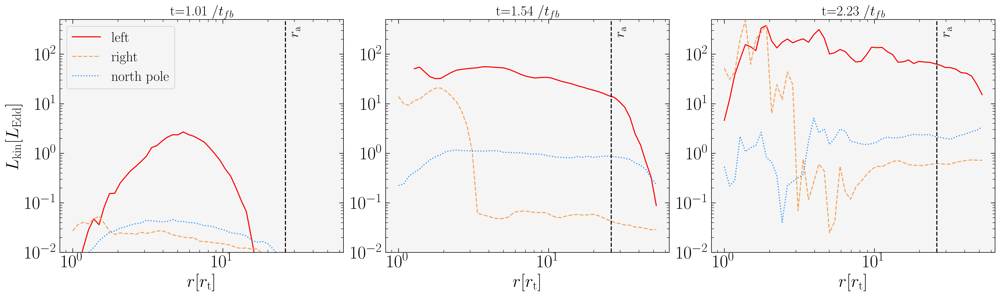

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(rf't={tfb:.2f} $/t_{{fb}}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


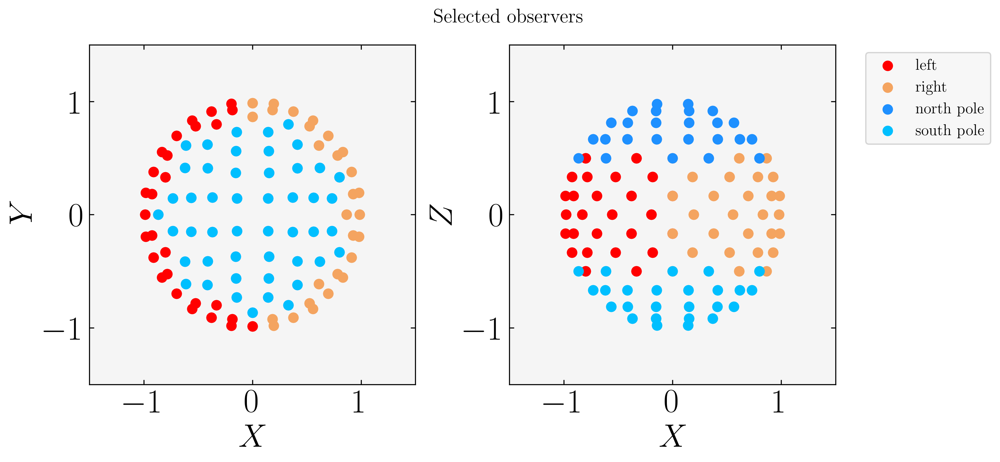

python(60255) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60256) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60257) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60258) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60259) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60260) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


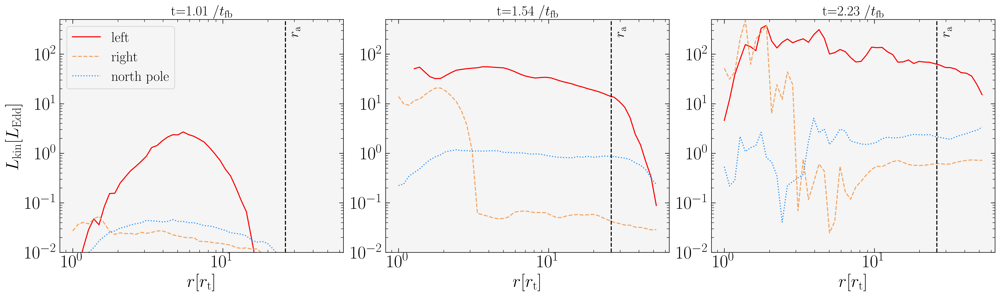

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(rf't={tfb:.2f} $/t_{{\rm fb}}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


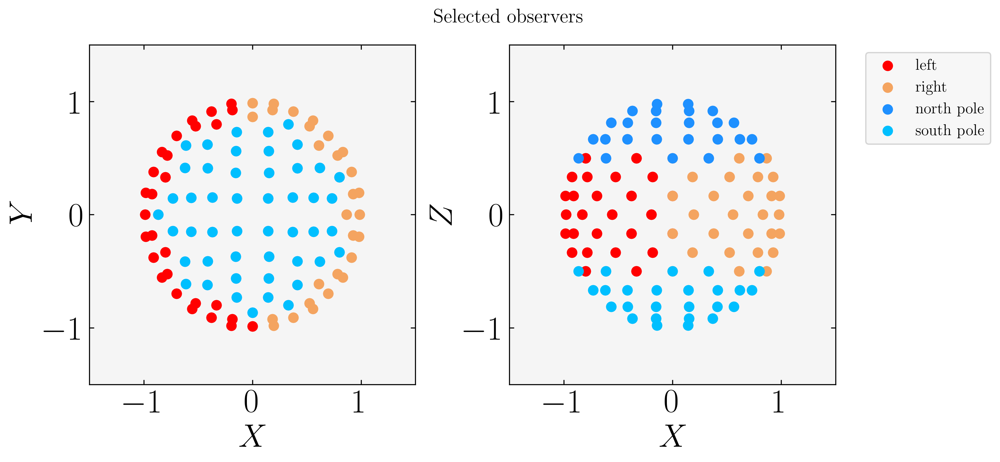

python(60275) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60276) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60277) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60278) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60279) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60280) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


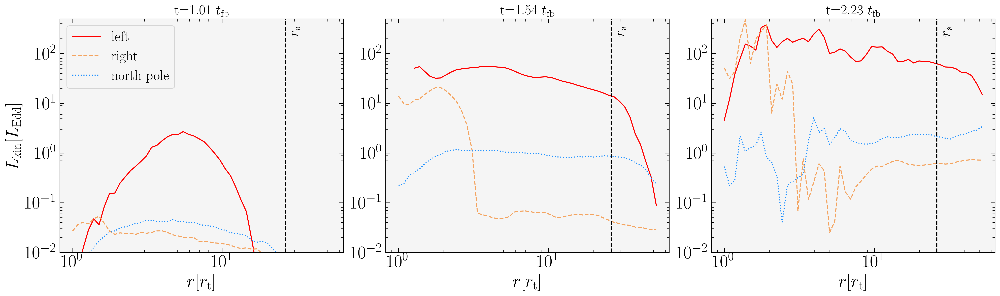

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(rf't={tfb:.2f} $t_{{\rm fb}}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


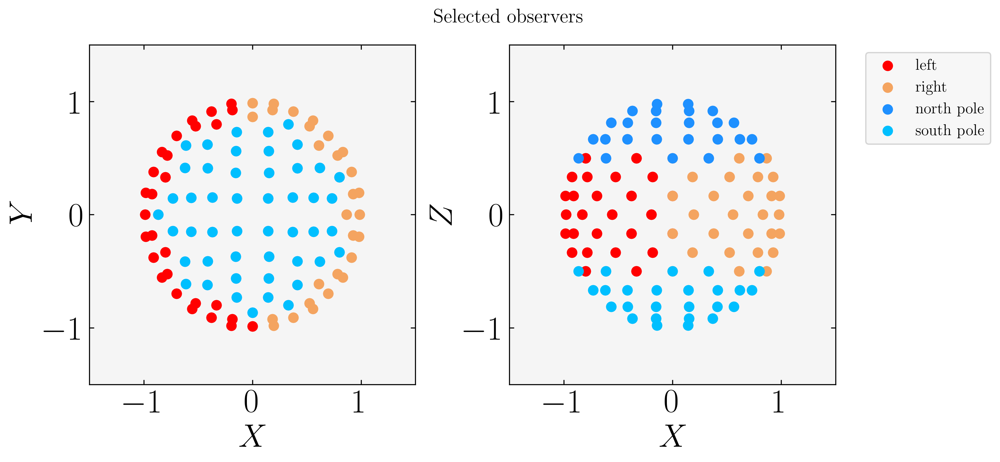

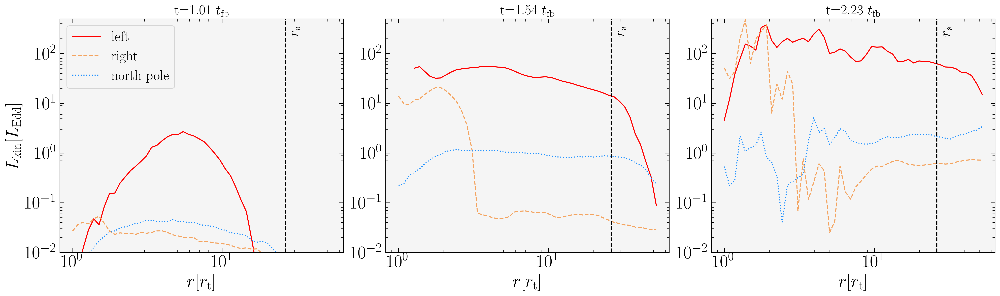

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=6)
        ax[s].tick_params(which='minor', direction='in', length=3.5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't={tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


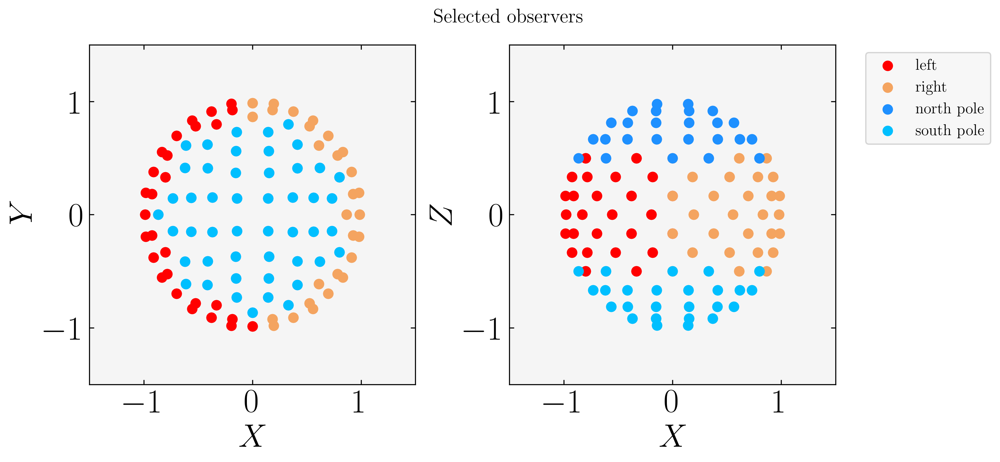

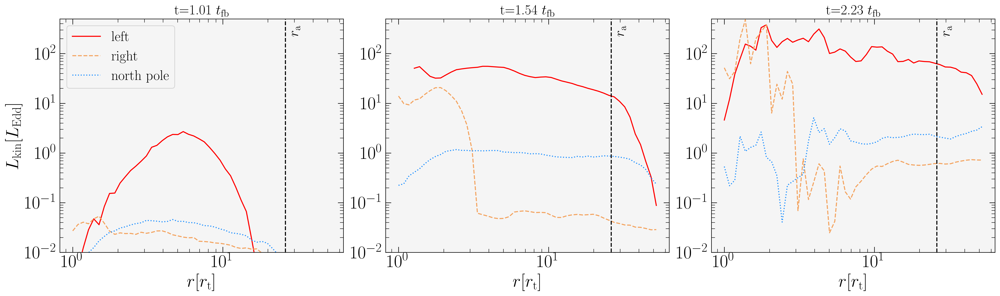

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't={tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 22
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-51-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-51-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


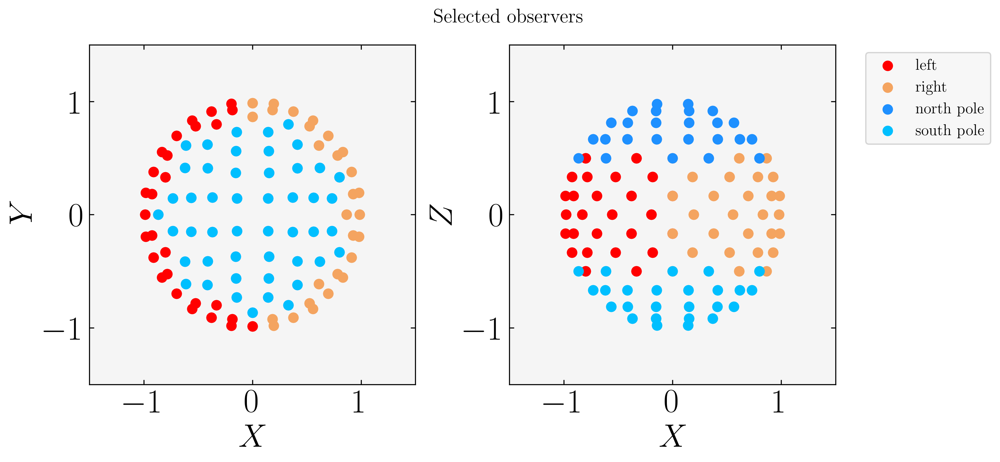

python(60652) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60653) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60654) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60655) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60656) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60657) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60658) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60659) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


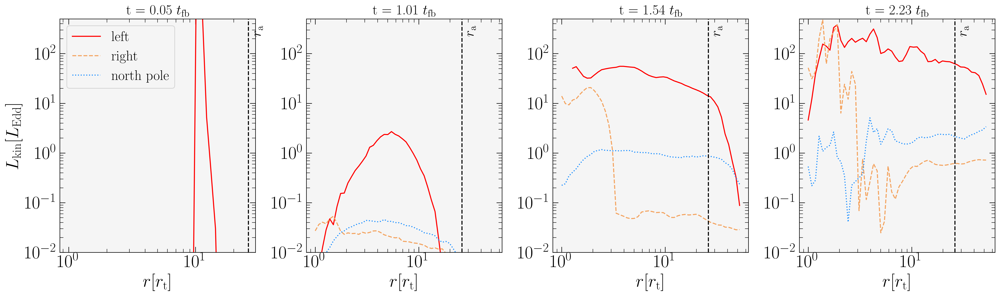

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [22, 76, 109, 151]
    lines_time = [':', '--', '-']
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(20,6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 45
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(2*apo), 50)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-54-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-54-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


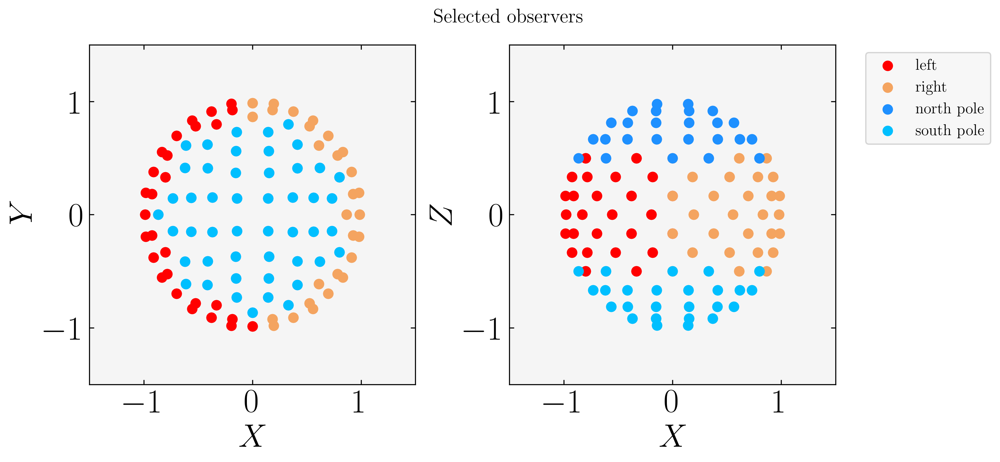

python(60667) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(60668) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


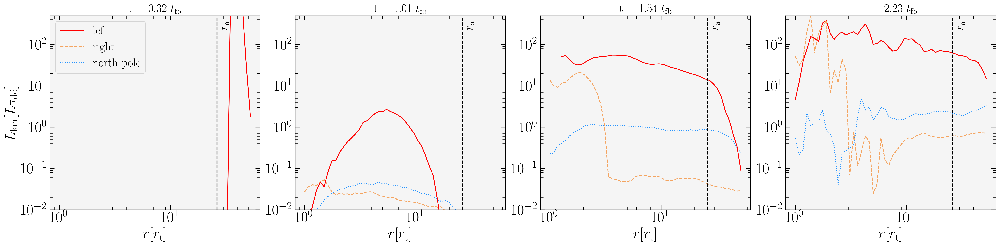

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [45, 76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(6*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


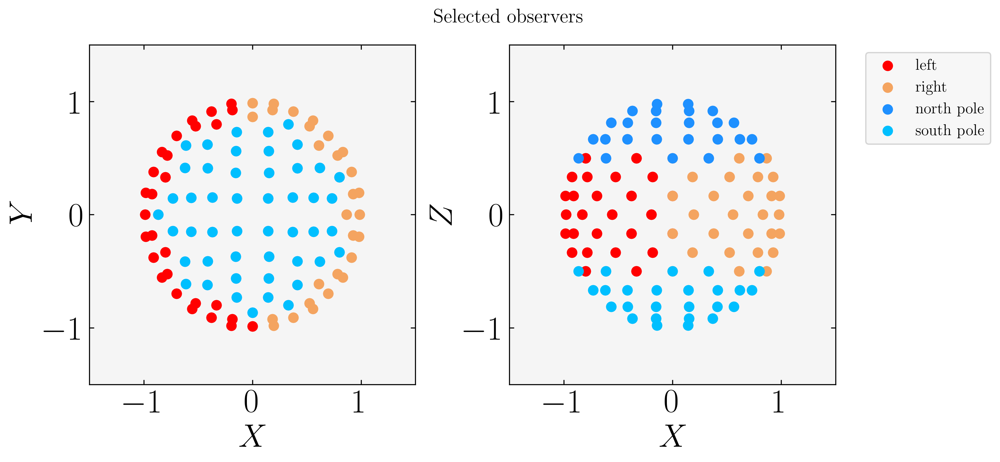

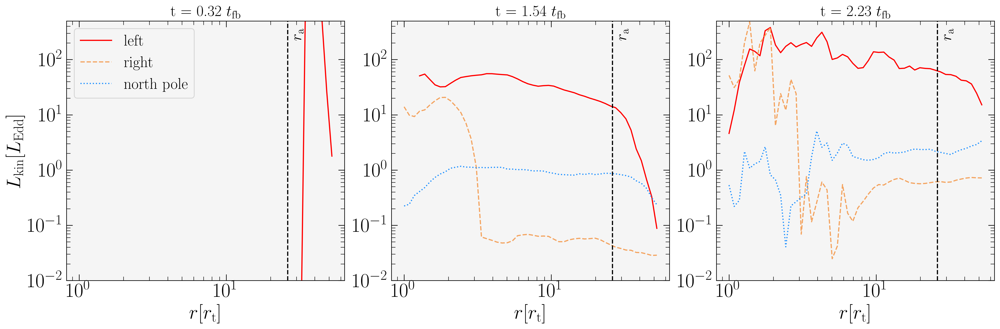

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [45,109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(6*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


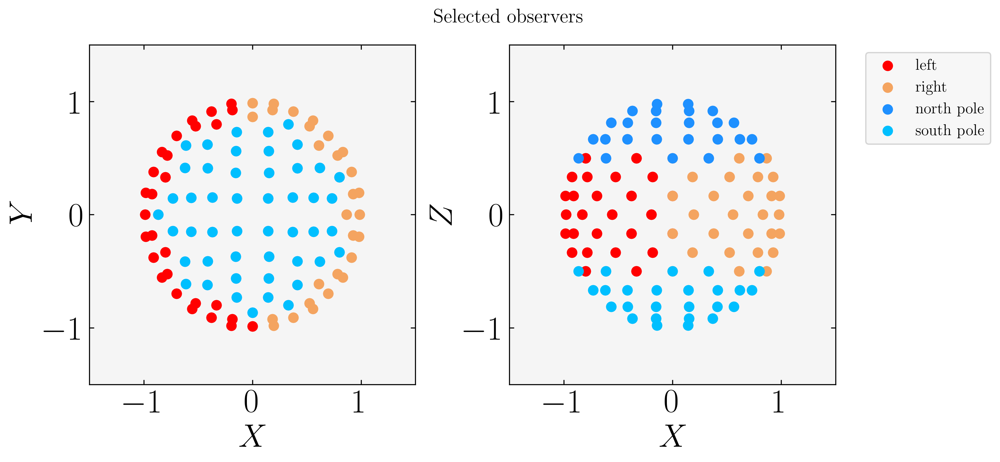

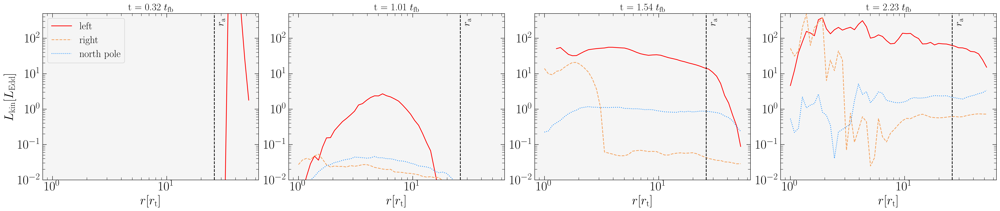

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [45, 76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


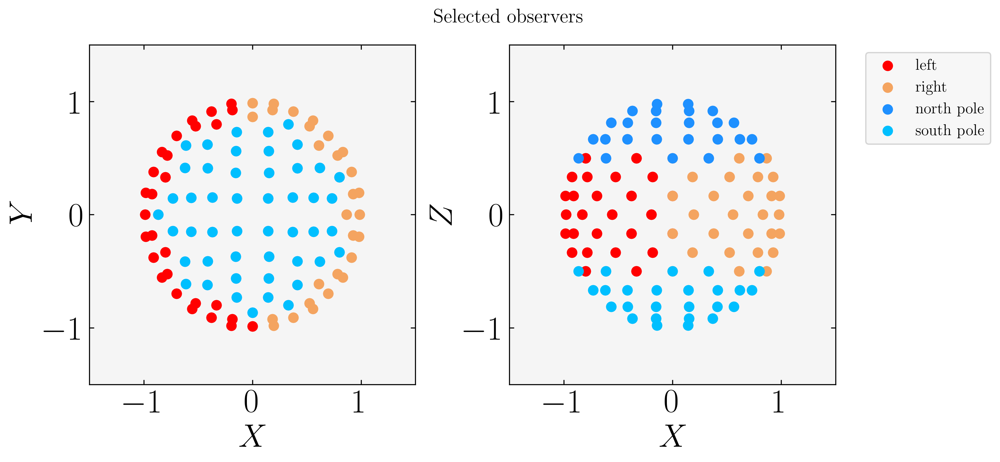

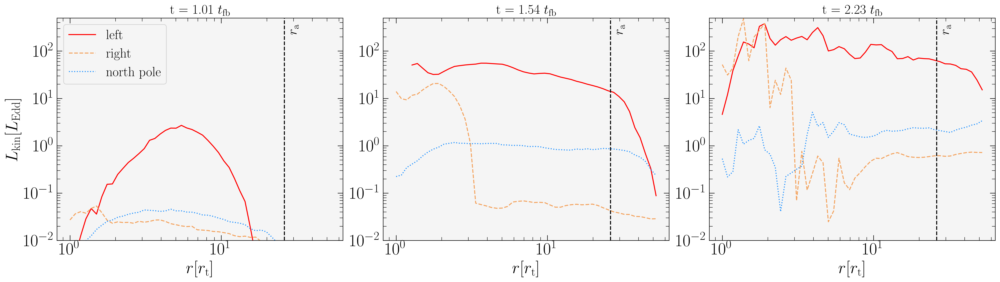

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
""" Compute kinetic luminosity as a function of radius for spherical sections"""
import sys
sys.path.append('/Users/paolamartire/shocks/')

from Utilities.isalice import isalice
alice, plot = isalice()
if alice:
    abspath = '/data1/martirep/shocks/shock_capturing'
    compute = True
else:
    abspath = '/Users/paolamartire/shocks'
    compute = False

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import csv
import os
import healpy as hp
from sklearn.neighbors import KDTree
import Utilities.prelude as prel
import src.orbits as orb
from Utilities.operators import make_tree, to_spherical_components, choose_sections, choose_observers, to_cylindric
from Utilities.selectors_for_snap import select_snap
from Utilities.sections import make_slices
from src.Wind.Mdot_Rfixed_sec import split_cells

##
#%% PARAMETERS
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 109
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-61-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-61-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


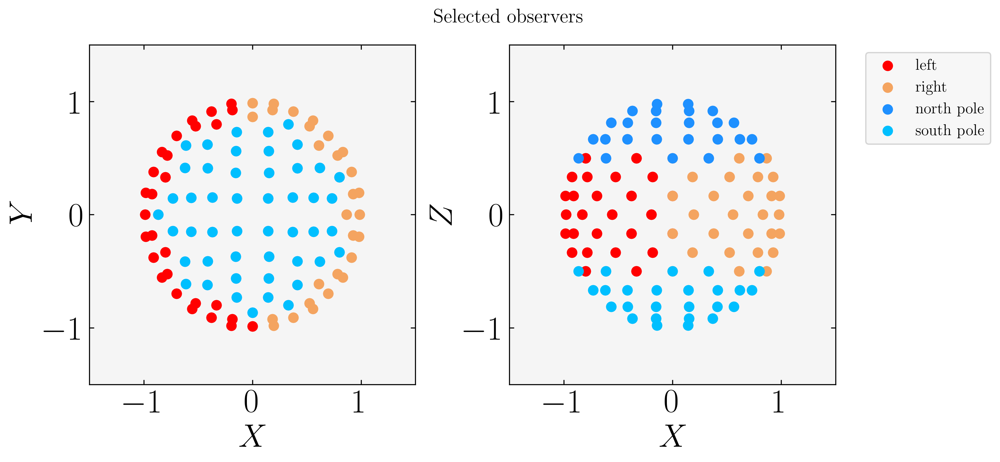

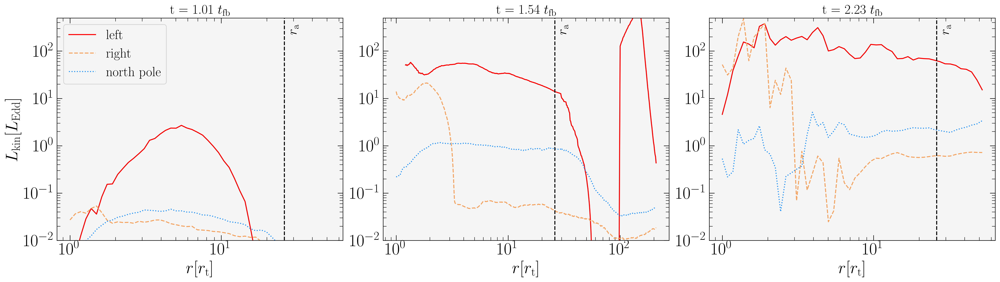

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


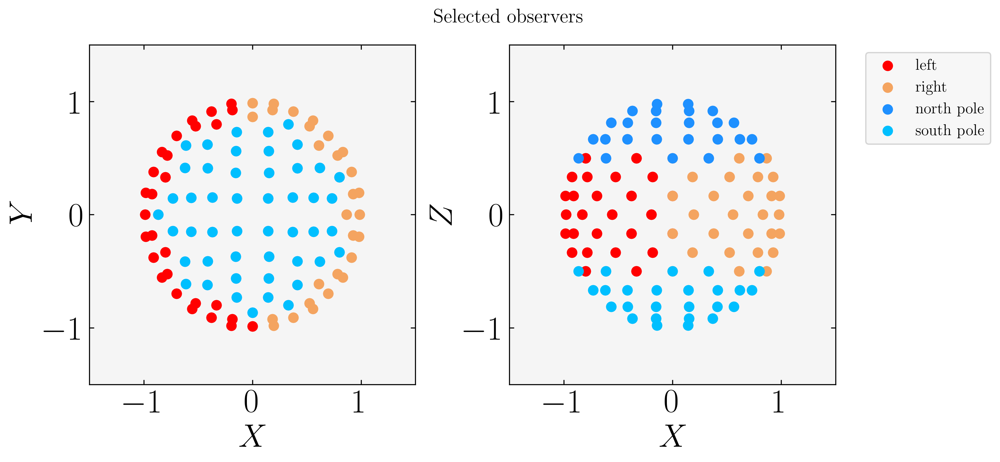

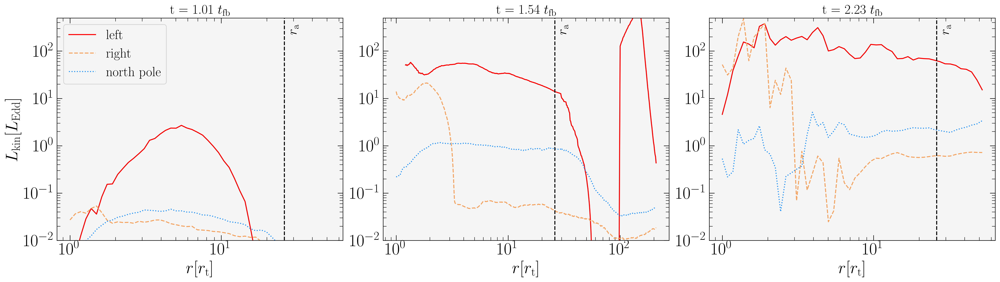

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


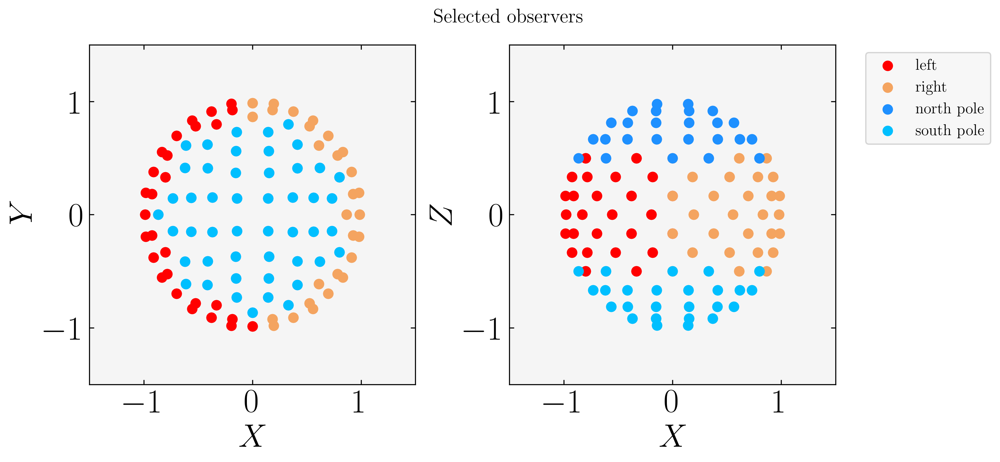

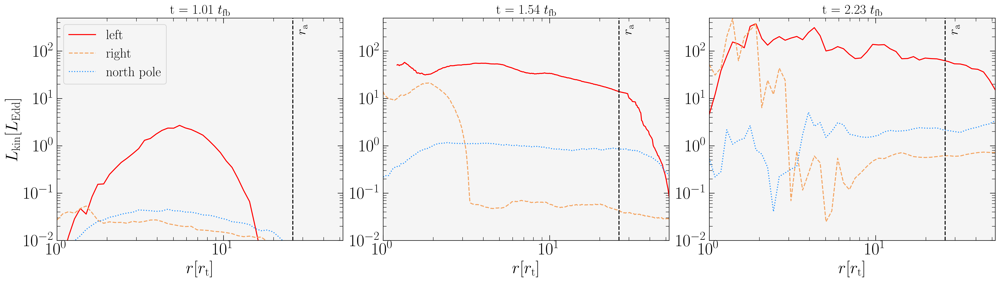

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_xlim(1, 2*apo/Rt)
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


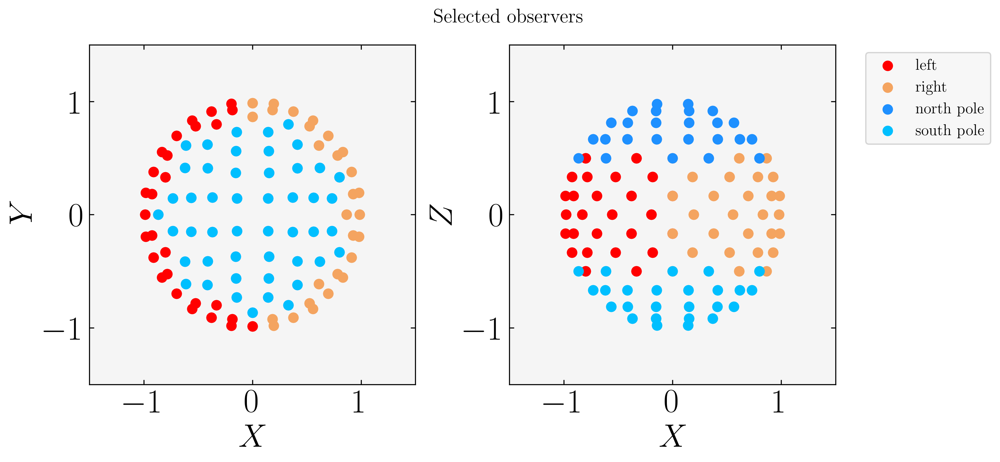

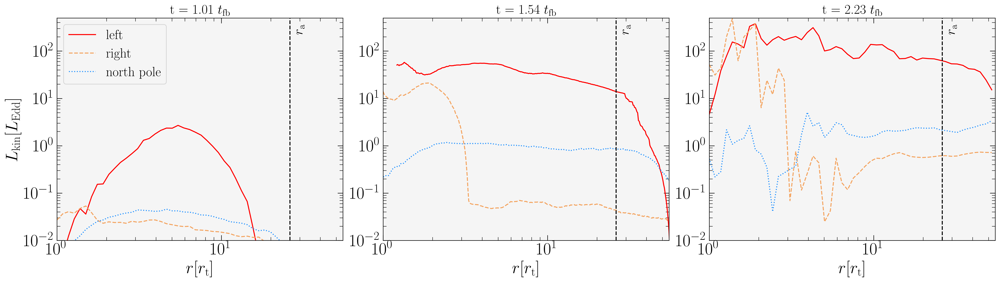

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_xlim(1, 2.1*apo/Rt)
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 45
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-67-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-67-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 76
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 151
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-70-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-70-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


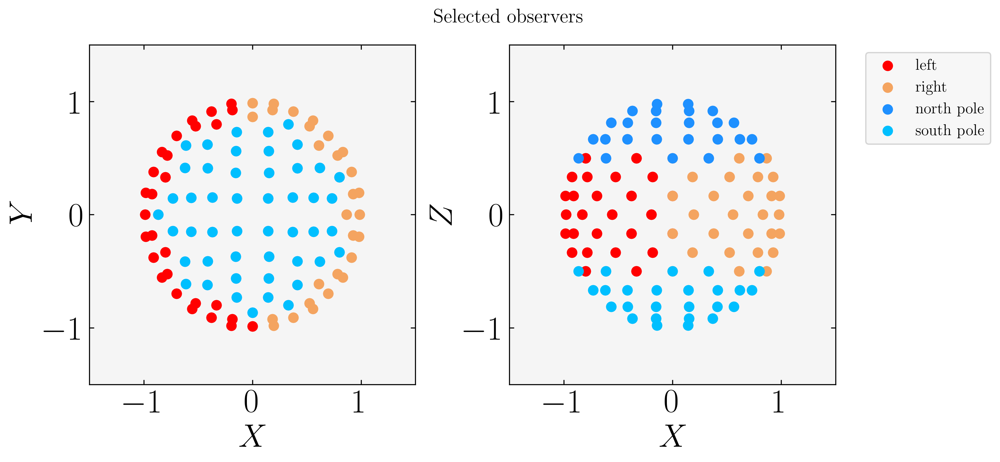

FileNotFoundError: /Users/paolamartire/shocks/data/R0.47M0.5BH10000beta1S60n1.5ComptonHiResNewAMR/wind/Lkin_HiResNewAMRdark_bright_z76.csv not found.

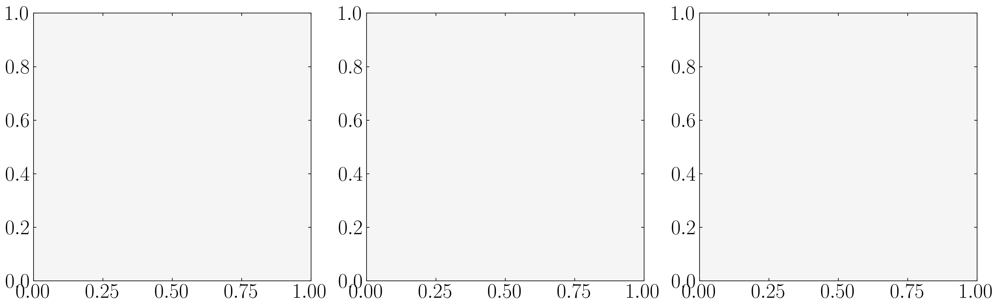

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_xlim(1, 2.1*apo/Rt)
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

In [ ]:
#
m = 4
Mbh = 10**4
Mbh_cgs = Mbh * prel.Msol_cgs
beta = 1
mstar = .5
Rstar = .47
n = 1.5
compton = 'Compton'
check = 'HiResNewAMR'
snap = 76
choice = 'dark_bright_z'

folder = f'R{Rstar}M{mstar}BH{Mbh}beta{beta}S60n{n}{compton}{check}'
csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
params = [Mbh, Rstar, mstar, beta]
things = orb.get_things_about(params)
tfallback = things['t_fb_days']
tfallback_cgs = tfallback * 24 * 3600 # converted to seconds
Rs = things['Rs']
Rg = things['Rg']
Rt = things['Rt']
Rp = things['Rp']
R0 = things['R0']
apo = things['apo']
amin = things['a_mb'] # semimajor axis of the bound orbit

Ledd_sol, Medd_sol = orb.Edd(Mbh, 1.44/(prel.Rsol_cgs**2/prel.Msol_cgs), 1, prel.csol_cgs, prel.G)
Ledd_cgs = Ledd_sol * prel.en_converter/prel.tsol_cgs
Medd_cgs = Medd_sol * prel.Msol_cgs/prel.tsol_cgs 
r_array = np.logspace(np.log10(Rt), np.log10(8*apo), 500)

In [ ]:
path = f'{abspath}/TDE/{folder}/{snap}'
data = make_tree(path, snap, energy = True)
tfb = np.loadtxt(f'{path}/tfb_{snap}.txt')
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    data.X, data.Y, data.Z, data.Vol, data.Den, data.Mass, data.Press, data.VX, data.VY, data.VZ, data.IE, data.Rad
cut = Den > 1e-19
X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den = \
    make_slices([X, Y, Z, Vol, Den, Mass, Press, VX, VY, VZ, IE_den, Rad_den], cut)
dim_cell = Vol**(1/3)
Rsph = np.sqrt(X**2 + Y**2 + Z**2)
V = np.sqrt(VX**2 + VY**2 + VZ**2)
bern = orb.bern_coeff(Rsph, V, Den, Mass, Press, IE_den, Rad_den, params)
v_rad, _, _ = to_spherical_components(VX, VY, VZ, X, Y, Z)

cond_wind = np.logical_and(v_rad >= 0, bern > 0)
X_wind, Y_wind, Z_wind, Rsph_wind, Den_wind, v_rad_wind, dim_cell_wind, Rad_den_wind, bern_wind = \
    make_slices([X, Y, Z, Rsph, Den, v_rad, dim_cell, Rad_den, bern], cond_wind)
indices_sec, label_obs, color_obs = split_cells(X_wind, Y_wind, Z_wind, choice)
Mdot_wind = np.pi * dim_cell_wind**2 * Den_wind * v_rad_wind
indices_wind = np.arange(len(X_wind))

for i, r in enumerate(r_array):
    Ekin = np.zeros(len(indices_sec))
    cond_r = np.abs(Rsph_wind - r) < dim_cell_wind
    indices_r = indices_wind[cond_r]
    for j, indices in enumerate(indices_sec):
        # print(indices)
        cond_sec_r = np.intersect1d(indices_r, indices) 
        Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
    # Save data
    data_tosave = np.concatenate(([r], Ekin))  
    with open(csv_path, 'a', newline='') as f:
        writer = csv.writer(f)
        if (not os.path.exists(csv_path)) or os.path.getsize(csv_path) == 0:
            header = ['r'] + [f'section_{lab}' for lab in label_obs]
            writer.writerow(header)
        writer.writerow(data_tosave)

<ipython-input-73-46480a5370ef>:30: RuntimeWarning: divide by zero encountered in scalar divide
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)
<ipython-input-73-46480a5370ef>:30: RuntimeWarning: invalid value encountered in scalar multiply
  Ekin[j] = r**2/np.sum(dim_cell_wind[cond_sec_r]**2) * 0.5 * np.sum(Mdot_wind[cond_sec_r] * v_rad_wind[cond_sec_r]**2)


Adjusting observers number


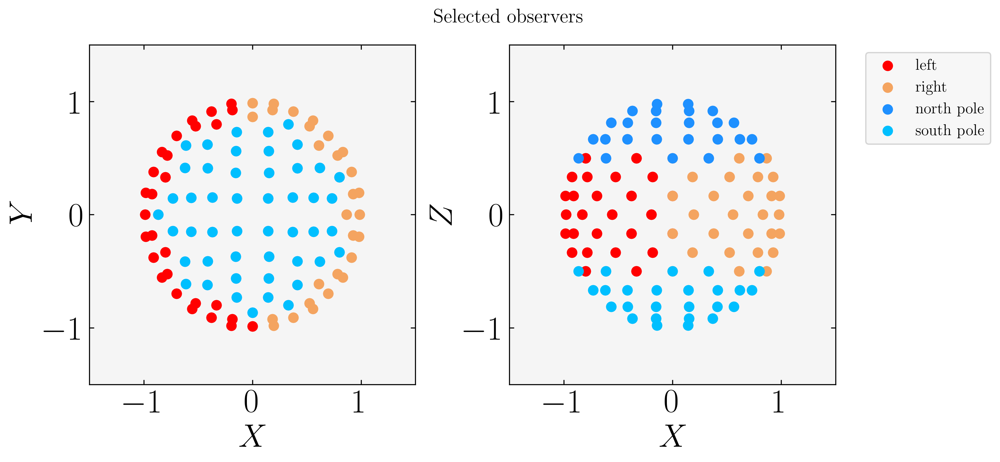

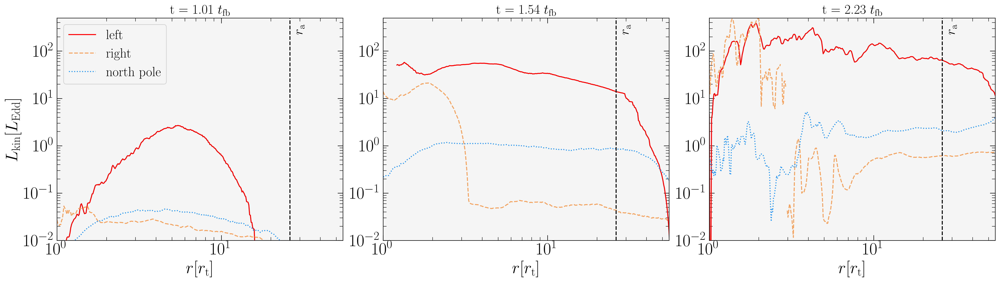

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_xlim(1, 2.1*apo/Rt)
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


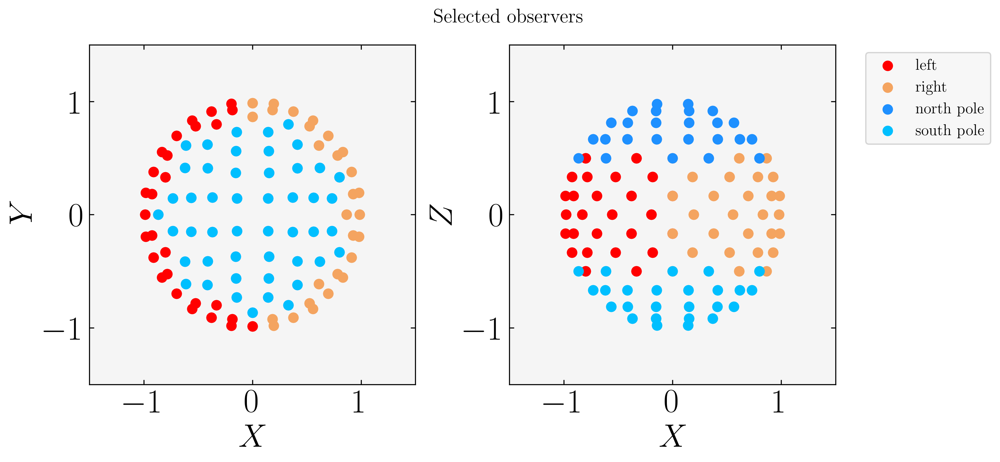

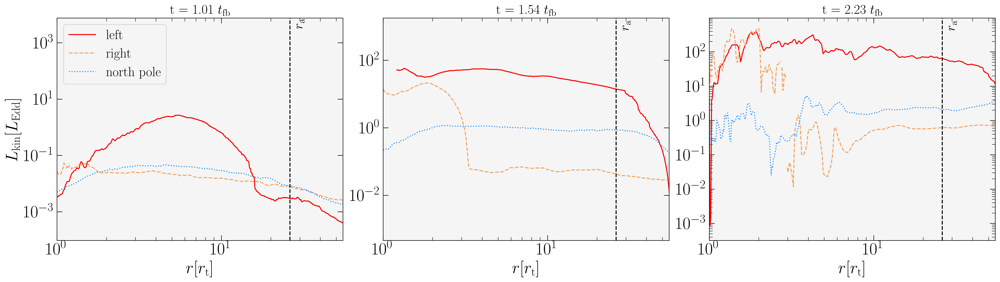

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        ax[s].set_xlim(1, 2.1*apo/Rt)
        # ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()

Adjusting observers number


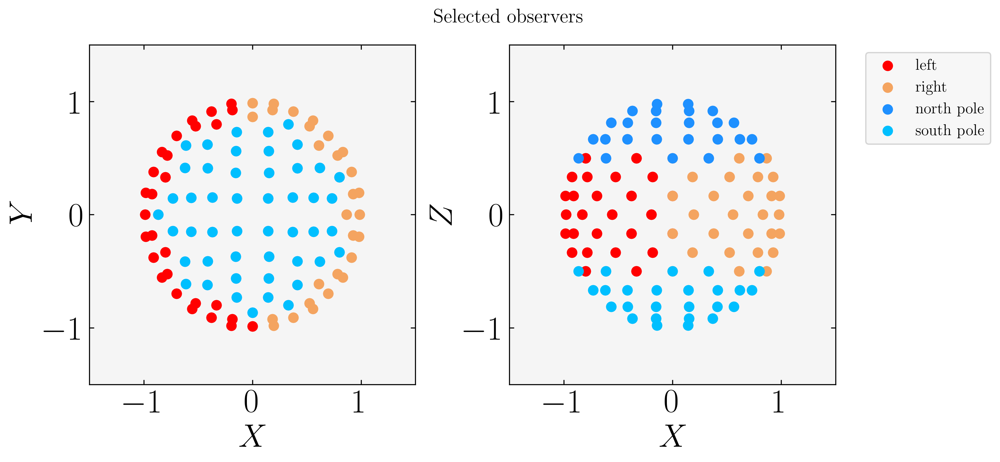

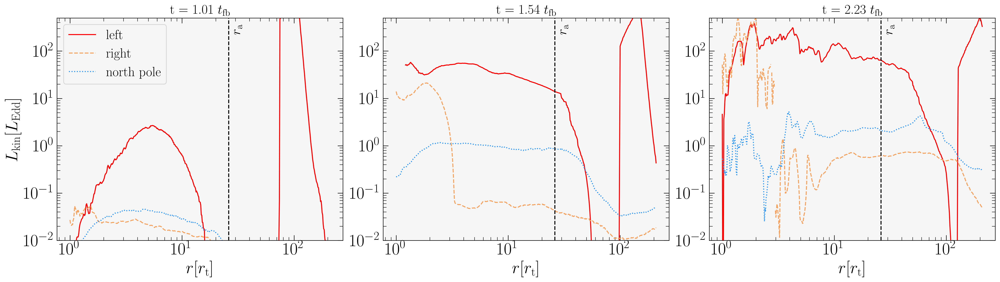

In [ ]:
if plot:
    observers_xyz = hp.pix2vec(prel.NSIDE, range(prel.NPIX))
    observers_xyz = np.array(observers_xyz)
    indices_obs, label_obs, colors_obs, lines_obs = choose_observers(observers_xyz, choice)
    snaps = [76, 109, 151]
    Dissdata = np.loadtxt(f'{abspath}/data/{folder}/paper1/Rdiss_{check}.csv', delimiter=',', dtype=float, skiprows=1)
    snapDiss, tfbDiss, Ldisstot_posH = Dissdata[:,0], Dissdata[:,1], Dissdata[:,3]

    fig, ax = plt.subplots(1, len(snaps), figsize=(7*len(snaps),6))
    for s, snap in enumerate(snaps):
        tfb = tfbDiss[snapDiss == snap][0]
        csv_path = f'{abspath}/data/{folder}/wind/Lkin_{check}{choice}{snap}.csv'
        Lkin = np.loadtxt(csv_path, 
                                delimiter = ',', 
                                skiprows=1, 
                                unpack=True) 
        r_toplot, LkL, LkR, LkN, LkS = Lkin[0], Lkin[1], Lkin[2], Lkin[3], Lkin[4]
        for i, Lum in enumerate([LkL, LkR, LkN]):
            ax[s].plot(r_toplot/Rt, Lum/Ledd_sol, label=label_obs[i], color=colors_obs[i], linestyle = lines_obs[i])

        ax[s].loglog()
        ax[s].set_xlabel(r'$r [r_{\rm t}]$')
        # ax[s].set_xlim(1, 2.1*apo/Rt)
        ax[s].set_ylim(1e-2, 5e2)
        ax[s].tick_params(which='major', direction='in', length=8)
        ax[s].tick_params(which='minor', direction='in', length=5)
        ax[s].axvline(apo/Rt, color = 'k', linestyle='--')
        ax[s].text(apo/Rt*1.05, ax[s].get_ylim()[1]*0.5, r'$r_{\rm a}$', rotation=90, fontsize=20)
        ax[s].set_title(f't = {tfb:.2f} ' + r'$t_{\rm fb}$', fontsize=20)

    ax[0].set_ylabel(r'$L_{\rm kin} [L_{\rm Edd}]$')
    ax[0].legend(fontsize=20)
    plt.tight_layout()